In [59]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import scipy.stats
import scipy
import math
import random
from scipy.stats import binom_test
from scipy.stats import kstest
from scipy.stats import norm
import sys 
from scipy.stats import binom
import matplotlib.pyplot as plt
import pandas as pd
from datetime import datetime
from scipy.stats import poisson
import random
import numpy as np
from numpy.random import random
import matplotlib.dates as mdates
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from pmdarima import auto_arima
import analysisimport as ai

In [89]:
class MonteCarlo:
    def __init__(self,analysis):
        self.hi = 2
        self.df = analysis.df
        self.analysis = analysis
        self.SMCstates = {}
        self.smoothdf = pd.DataFrame()

    # state space model - Mutation
    def StateSpace_iplus1_mean(self,xt,v):
        dummy = xt+np.random.normal(0,scale =np.sqrt(v))
        # print('oub: ',dummy)
        while dummy<0:
            dummy = xt+np.random.normal(0,scale =np.sqrt(v))
        # print("fixed")
        return(dummy)
        #return(Xt_1 *dnp.random.lognormal(mean=0.0, sigma=1.0)
        #return(Xt_1*np.random.exponential(scale = 1))
    def StateSpace_iplus1_var(self,v,pt):
        return(v*np.random.lognormal(mean = 0,sigma = pt))

    def transitionkernels(self,x,statevar1,statevar2,covv):
        # dummy = x+np.random.normal(0,scale =np.sqrt(v))
        covv = np.sqrt(statevar1) * np.sqrt(statevar2)*covv
        cov_mat = [[statevar1,covv],[covv,statevar2]]
        dummy = x + np.random.multivariate_normal([0,0],cov_mat)
        # print('oub: ',dummy)
        while dummy[0]<0 or dummy[1]<0:
            dummy = x + np.random.multivariate_normal([0,0],cov_mat)
        # print("fixed")
        return(dummy)
    def logtransitionkernels(self,X,Y,Sdx,Sdy,Corr):
        LX = np.log(X)
        LY = np.log(Y)
        cov_mat = [[Sdx**2,Sdx*Sdy*Corr],[Sdx*Sdy*Corr,Sdy**2]]
        dummy = [LX,LY] + np.random.multivariate_normal([0,0],cov_mat)
        return(dummy)

    def StateSpace_iplus1corr(self,xt):
        wt = xt + np.random.normal(0,0.05)
        while wt>1 or wt<-1:
            wt = xt + np.random.normal(0,0.05)
        #print(wt)
        return(wt)
            
    #Mutation
    def hiddenmodel_iplus1(self,obs1,mu1,obs2,mu2):
        return(poisson.pmf(obs1,mu1)*poisson.pmf(obs2,mu2))
    
    def hiddenmodel_i_plus_1_var(self,observation,statemean,statevar):
        return(scipy.stats.norm.pdf(observation,statemean,np.sqrt(statevar)))

    def general_filter(self,obs1,obs2,N,param):
        ParticlesSdx = np.zeros((N,len(obs1)))
        ParticlesSdy =  np.zeros((N,len(obs1)))
        ParticlesCorr =  np.zeros((N,len(obs1)))
        ParticlesX =  np.zeros((N,len(obs1)))
        ParticlesY =  np.zeros((N,len(obs1)))
        ParticlesIndicies =  np.zeros((N,len(obs1)))

        obs1 = np.array(obs1)
        obs2 = np.array(obs2)

        Sdx = np.zeros(N)
        Sdy = np.zeros((N))
        Corr= np.zeros((N))
        X= np.zeros((N))
        Y= np.zeros((N))
        # Initial prior distribution for our unobservable quantity of interest
        Sdx = [np.random.uniform(0,3) for i in range(0,N)]
        Sdy = [np.random.uniform(0,3) for i in range(0,N)]
        Corr = [np.random.uniform(-1,1) for elem in range(N)]
        X = [np.random.uniform(0,10) for elem in range(N)]
        Y = [np.random.uniform(0,10) for elem in range(N)]
        Sdx = np.array(Sdx)
        Sdy = np.array(Sdy)
        Corr = np.array(Corr)
        X= np.array(X)
        Y = np.array(Y)

        for i in range(0,len(obs1)):
            #Give the parameter for our state space model and updated rate 
            # having ovserved our data point Y[i]
            [Sdx,Sdy,Corr,X,Y,I] = self.Filter(Sdx,Sdy,Corr,X,Y,obs1[i],obs2[i],N,param)
            ParticlesSdx[:,i] = Sdx
            ParticlesSdy[:,i] = Sdy
            ParticlesCorr[:,i] = Corr
            ParticlesX[:,i] = X
            ParticlesY[:,i] = Y
            ParticlesIndicies[:,i] = I
            print(i)

        #print(RoundedIndicies.shape)
        return(ParticlesSdx,ParticlesSdy,ParticlesCorr,ParticlesX,ParticlesY,ParticlesIndicies)

    def Filter(self,Sdx,Sdy,Corr,X,Y,Xobs,Yobs,N,param):
        Weights = np.zeros(N)
        #For each particle in our filter
        #Particles are a 2xN object
        #Draw a sample from our 'proposal distribution' i.e. for computing predictive step
        for i in range(0,N):
            Sdx[i] = self.StateSpace_iplus1_var(Sdx[i],param)
            Sdy[i] = self.StateSpace_iplus1_var(Sdy[i],param)
            Corr[i] = self.StateSpace_iplus1corr(Corr[i])

            [LX,LY] = self.logtransitionkernels(X[i],Y[i],Sdx[i],Sdy[i],Corr[i])
            X[i] = np.exp(LX)
            Y[i] =np.exp(LY)

            Weights[i] = self.hiddenmodel_iplus1(Xobs,X[i],Yobs,Y[i])


        #Normalise weights
        sumW = sum(Weights)
        for i in range(N):
            Weights[i] = Weights[i]/sumW
        #Resample from these weights    

        I = np.random.choice(list(range(N)),replace = True, size = N, p = Weights)
        # print(I)
        Sdx = Sdx[I]
        Sdy = Sdy[I]
        Corr = Corr[I]
        X = X[I]
        Y = Y[I]
                
        #Convert to state space vectors
        return(Sdx,Sdy,Corr,X,Y,I)
    
    def movingaveragemontecarlo(self,ID1,ID2,K,N,pt,pltshow = True):
        p_est_dict = {}
        vals = self.df[ID1]
        df_dummy = self.df.copy()
        [ParticlesSdx,ParticlesSdy,ParticlesCorr,ParticlesX,ParticlesY,ParticlesIndicies] = self.general_filter(self.df[ID1],self.df[ID2],N,pt)
        #self.SMCstates[ID] = Indicies
        #np.savetxt("States.txt",Indicies , delimiter=",")
        variances = np.mean(ParticlesSdx,axis = 0)
        #dfp.rolling(7, center=True).mean()
        hi = pd.DataFrame(vals)
        dude = pd.DataFrame(hi).rolling(K, center=True).mean()        
        dudevar = pd.DataFrame(hi).rolling(30, center=True).var()  
        
        df_dummy['Plottingrate'] = np.mean(ParticlesX,axis = 0)
        if pltshow == True:
            ID=ID1
            figure(figsize=(5, 20), dpi=320)
            fig, ax = plt.subplots(nrows = 2, ncols  =1, sharex = True, sharey = False)
            plt.subplots_adjust(hspace = 0)
            ax[0].plot(self.df.index.values,df_dummy['Plottingrate'], color = 'red')
            ax[0].bar(self.df.index.values, dude[ID] ,width = 0.3)
            ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
            ax[0].set_xlabel('Date')
            ax[0].title.set_text(ID)
            ax[0].set_ylabel('Frequency')
            
            #ax2 = ax.twinx()
            #widthintervals = [0.1 + 0.2*(np.log10(changeinvar[i])) for i in range(0,255)]#np.log(cinvar[-1])#initialwidth*np.abs(cinvar[-1]-1)
            ax[1].plot(self.df.index.values,variances,label = 'widths',color = plt.cm.viridis(.9))
            ax[1].plot(self.df.index.values,dudevar[ID1],label = 'widths',color = plt.cm.viridis(0))
            ax[1].set_ylabel('Variance')
            #plt.savefig('./Plots/SMC_dyn_interval/'+ID)
            #ax[1].set_ylim(top = 1)
            plt.show()
        print("ID2")
        vals = self.df[ID2]
        print("1")
        df_dummy = self.df.copy()
        variances = np.mean(ParticlesSdy,axis = 0)
        #dfp.rolling(7, center=True).mean()
        hi = pd.DataFrame(vals)
        dude = pd.DataFrame(hi).rolling(K, center=True).mean()        
        dudevar = pd.DataFrame(hi).rolling(30, center=True).var()  
        # print("2")

        
        df_dummy['Plottingrate'] = np.mean(ParticlesY,axis = 0)
        if pltshow == True:
            ID=ID2
            # print("3")

            figure(figsize=(5, 20), dpi=320)
            fig, ax = plt.subplots(nrows = 2, ncols  =1, sharex = True, sharey = False)
            plt.subplots_adjust(hspace = 0)
            ax[0].plot(self.df.index.values,df_dummy['Plottingrate'], color = 'red')
            ax[0].bar(self.df.index.values, dude[ID] ,width = 0.3)
            # print("4")
            
            ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
            ax[0].set_xlabel('Date')
            ax[0].title.set_text(ID)
            ax[0].set_ylabel('Frequency')
            # print("1")
            
            #ax2 = ax.twinx()
            #widthintervals = [0.1 + 0.2*(np.log10(changeinvar[i])) for i in range(0,255)]#np.log(cinvar[-1])#initialwidth*np.abs(cinvar[-1]-1)
            ax[1].plot(self.df.index.values,variances,label = 'widths',color = plt.cm.viridis(.9))
            ax[1].plot(self.df.index.values,dudevar[ID2],label = 'widths',color = plt.cm.viridis(0))
            ax[1].set_ylabel('Variance')
            # print("1")

            #plt.savefig('./Plots/SMC_dyn_interval/'+ID)
            #ax[1].set_ylim(top = 1)
            plt.show()
        Corr = np.mean(ParticlesCorr,axis = 0)
        plt.plot(self.df.index.values,Corr)
        plt.show()
        # return(MeanStates1,VarStates1,Imean,Ivar)

In [87]:
def get_ancestry(States,Indicies):
    trajectory_ind = np.zeros(Indicies.shape[1])
    trajectory_states = np.zeros(Indicies.shape[1])
    index =0
    
    for i in reversed(range(0,Indicies.shape[1])):
        #index before:
        trajectory_states[i] = States[index,i]

        index = int(Indicies[index,i])
        trajectory_ind[i] = index
        print(index)
    return(trajectory_states, trajectory_ind)

In [90]:
import pickle
analysis3 = ai.Model()
df = analysis3.df
Accuracy = 20
N = 3000
IDs = list(analysis3.df)
K = 2
state_dict_Sdx = {}
state_dict_Sdy = {}
state_dict_Corr = {}
state_dict_X = {}
state_dict_Y = {}
# hi = MonteCarlo()
cols = list(df)[:-1]

for ii in range(len(cols)):
    ID1 = cols[ii]
    for jj in range(ii+1,len(cols)):
        ID2 = cols[jj]

        print('Smoother for ', ID1, " and ",ID2)
        try:
            Ancestry_matrixSdx = np.zeros((Accuracy,len(analysis3.df[ID])))
            Ancestry_matrixSdy = np.zeros((Accuracy,len(analysis3.df[ID])))
            Ancestry_matrixCorr = np.zeros((Accuracy,len(analysis3.df[ID])))
            Ancestry_matrixX = np.zeros((Accuracy,len(analysis3.df[ID])))
            Ancestry_matrixY = np.zeros((Accuracy,len(analysis3.df[ID])))
            # Ancestry_matrix_var = np.zeros((Accuracy,len(analysis3.df[ID])))
            hi = MonteCarlo(analysis3)
            pt = 0.05
            for i in range(Accuracy):
                hi = MonteCarlo(analysis3)
                #[rate,ParticleStates,changeinvar,p,q] = self.general_filter(self.df[ID],N)
                #[,IndiciesVar] = hi.general_filter(analysis3.df[ID],2000,t1 = (Accuracy), t2 = 100*i/(Accuracy))
                [ParticlesSdx,ParticlesSdy,ParticlesCorr,ParticlesX,ParticlesY,Indicies] = hi.general_filter(df[ID1],df[ID2],N,pt)
                #Accuracy *len(IDs) for global percentage counter
                [Ancestry_matrixSdx[i,:],h] = get_ancestry(ParticlesSdx,Indicies)
                [Ancestry_matrixSdy[i,:],h] = get_ancestry(ParticlesSdy,Indicies)
                [Ancestry_matrixCorr[i,:],h] = get_ancestry(ParticlesCorr,Indicies)
                [Ancestry_matrixX[i,:],h] = get_ancestry(ParticlesX,Indicies)
                [Ancestry_matrixY[i,:],h] = get_ancestry(ParticlesY,Indicies)
                print('\n', int(100*(i+1)/Accuracy),'% SMCs.')
            
                IDNOM = ID1+ID2
                state_dict_Sdx[IDNOM] = Ancestry_matrixSdx
                state_dict_Sdy[IDNOM] = Ancestry_matrixSdy
                state_dict_Corr[IDNOM] = Ancestry_matrixCorr
                state_dict_X[IDNOM] = Ancestry_matrixX
                state_dict_Y[IDNOM] = Ancestry_matrixY

                with open('./smoothingdata/CovarianceMeasureparam1/SdxStates.pickle', 'wb') as meanfile:
                    pickle.dump(state_dict_Sdx,meanfile,protocol = pickle.HIGHEST_PROTOCOL)
                with open('./smoothingdata/CovarianceMeasureparam1/SdyStates.pickle', 'wb') as meanfile:
                    pickle.dump(state_dict_Sdy,meanfile,protocol = pickle.HIGHEST_PROTOCOL)
                with open('./smoothingdata/CovarianceMeasureparam1/CorrStates.pickle', 'wb') as meanfile:
                    pickle.dump(state_dict_Corr,meanfile,protocol = pickle.HIGHEST_PROTOCOL)
                with open('./smoothingdata/CovarianceMeasureparam1/XStates.pickle', 'wb') as meanfile:
                    pickle.dump(state_dict_X,meanfile,protocol = pickle.HIGHEST_PROTOCOL)
                with open('./smoothingdata/CovarianceMeasureparam1/YStates.pickle', 'wb') as meanfile:
                    pickle.dump(state_dict_Y,meanfile,protocol = pickle.HIGHEST_PROTOCOL)
                pltshow = True
                p_est_dict = {}
                vals = df[ID1]
                df_dummy = df.copy()
                
                #self.SMCstates[ID] = Indicies
                #np.savetxt("States.txt",Indicies , delimiter=",")
                variances = np.mean(ParticlesSdx,axis = 0)
                #dfp.rolling(7, center=True).mean()
                hi = pd.DataFrame(vals)
                dude = pd.DataFrame(hi).rolling(K, center=True).mean()        
                dudevar = pd.DataFrame(hi).rolling(30, center=True).var()  
                
                df_dummy['Plottingrate'] = np.mean(ParticlesX,axis = 0)
                if pltshow == True:
                    ID=ID1
                    figure(figsize=(5, 20), dpi=320)
                    fig, ax = plt.subplots(nrows = 2, ncols  =1, sharex = True, sharey = False)
                    plt.subplots_adjust(hspace = 0)
                    ax[0].plot(df.index.values,df_dummy['Plottingrate'], color = 'red')
                    ax[0].bar(df.index.values, dude[ID] ,width = 0.3)
                    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
                    ax[0].set_xlabel('Date')
                    ax[0].title.set_text(ID)
                    ax[0].set_ylabel('Frequency')
                    
                    #ax2 = ax.twinx()
                    #widthintervals = [0.1 + 0.2*(np.log10(changeinvar[i])) for i in range(0,255)]#np.log(cinvar[-1])#initialwidth*np.abs(cinvar[-1]-1)
                    ax[1].plot(df.index.values,variances,label = 'widths',color = plt.cm.viridis(.9))
                    ax[1].plot(df.index.values,dudevar[ID1],label = 'widths',color = plt.cm.viridis(0))
                    ax[1].set_ylabel('Variance')
                    plt.savefig('./Plots/SmoothedSMC/CovPlotsq/Obs/'+ID)
                    #ax[1].set_ylim(top = 1)
                    plt.show()
                print("ID2")
                vals = df[ID2]
                print("1")
                df_dummy = df.copy()
                variances = np.mean(ParticlesSdy,axis = 0)
                #dfp.rolling(7, center=True).mean()
                hi = pd.DataFrame(vals)
                dude = pd.DataFrame(hi).rolling(K, center=True).mean()        
                dudevar = pd.DataFrame(hi).rolling(30, center=True).var()  
                # print("2")

                
                df_dummy['Plottingrate'] = np.mean(ParticlesY,axis = 0)
                if pltshow == True:
                    ID=ID2
                    # print("3")

                    figure(figsize=(5, 20), dpi=320)
                    fig, ax = plt.subplots(nrows = 2, ncols  =1, sharex = True, sharey = False)
                    plt.subplots_adjust(hspace = 0)
                    ax[0].plot(df.index.values,df_dummy['Plottingrate'], color = 'red')
                    ax[0].bar(df.index.values, dude[ID] ,width = 0.3)
                    # print("4")
                    
                    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
                    ax[0].set_xlabel('Date')
                    ax[0].title.set_text(ID)
                    ax[0].set_ylabel('Frequency')
                    # print("1")
                    
                    #ax2 = ax.twinx()
                    #widthintervals = [0.1 + 0.2*(np.log10(changeinvar[i])) for i in range(0,255)]#np.log(cinvar[-1])#initialwidth*np.abs(cinvar[-1]-1)
                    ax[1].plot(df.index.values,variances,label = 'widths',color = plt.cm.viridis(.9))
                    ax[1].plot(df.index.values,dudevar[ID2],label = 'widths',color = plt.cm.viridis(0))
                    ax[1].set_ylabel('Variance')
                    # print("1")

                    #plt.savefig('./Plots/SMC_dyn_interval/'+ID)
                    plt.savefig('./Plots/SmoothedSMC/CovPlotsq/Obs/'+ID)

                    #ax[1].set_ylim(top = 1)
                    plt.show()
                fig, ax = plt.subplots(nrows = 1, ncols  =1, sharex = True, sharey = False)
                plt.subplots_adjust(hspace = 0)
                Corr = np.mean(ParticlesCorr,axis = 0)
                ax.plot(df.index.values,Corr)
                ax.xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
                plt.title(str(ID1) + " against " + str(ID2))
                plt.xlabel("Month")
                plt.ylabel("Covariance")
                plt.savefig("./Plots/SmoothedSMC/CovPlotsq/"+str(IDNOM))
                plt.show()
            # return(MeanStates1,VarStates1,Imean,Ivar)
            # input()
        except Exception as e:
            print(e)
            continue


Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities
Smoother for  Racism  and  Sexual minorities
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52


Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities


<Figure size 1600x6400 with 0 Axes>

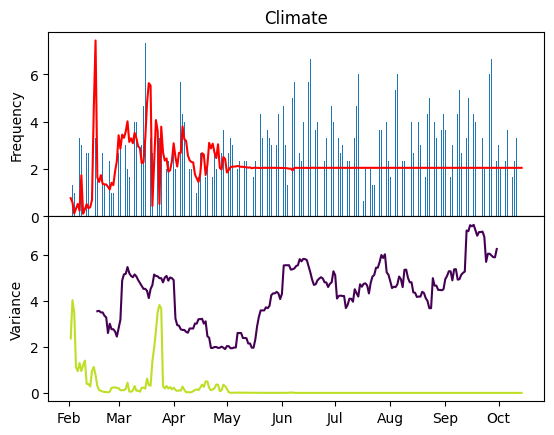

ID2
1


<Figure size 1600x6400 with 0 Axes>

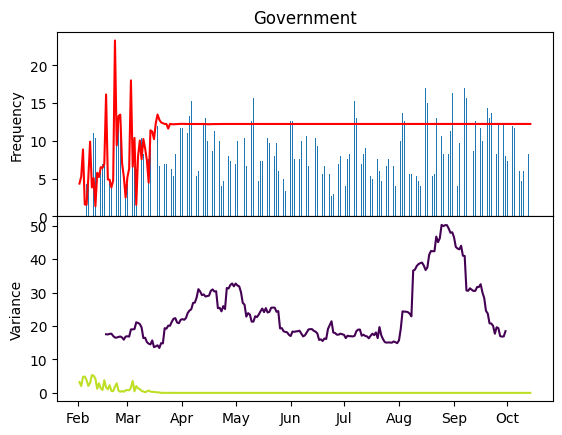

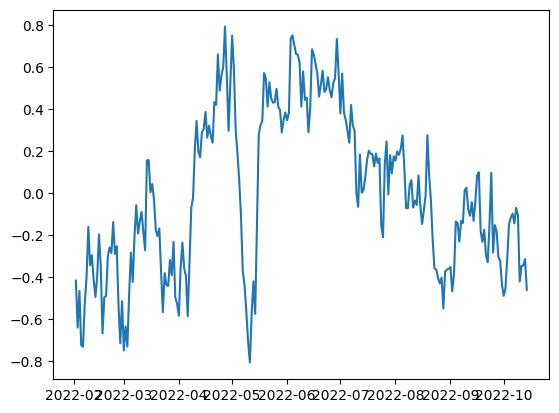

2.6807494163513184


In [ ]:
import time
analysis3 = ai.Model()
hi = MonteCarlo(analysis3)
t = time.time()

pt = 0.8
hi.movingaveragemontecarlo('Climate','Government',3,10,pt)
elapsed = time.time() -t
print(elapsed)

In [ ]:
class MonteCarlo:
    def __init__(self,analysis):
        self.hi = 2
        self.df = analysis.df
        self.analysis = analysis
        self.SMCstates = {}
        self.smoothdf = pd.DataFrame()

    # state space model - Mutation
    def StateSpace_iplus1_mean(self,xt,v):
        dummy = xt+np.random.normal(0,scale =np.sqrt(v))
        # print('oub: ',dummy)
        while dummy<0:
            dummy = xt+np.random.normal(0,scale =np.sqrt(v))
        # print("fixed")
        return(dummy)
        #return(Xt_1 *dnp.random.lognormal(mean=0.0, sigma=1.0)
        #return(Xt_1*np.random.exponential(scale = 1))
    def StateSpace_iplus1_var(self,v,pt):
        return(v*np.random.uniform(0.8,1.2))#np.random.lognormal(mean = 0,sigma = pt))

    def transitionkernels(self,x,statevar1,statevar2,covv):
        # dummy = x+np.random.normal(0,scale =np.sqrt(v))
        covv = np.sqrt(statevar1) * np.sqrt(statevar2)*covv
        cov_mat = [[statevar1,covv],[covv,statevar2]]
        dummy = x + np.random.multivariate_normal([0,0],cov_mat)
        # print('oub: ',dummy)
        while dummy[0]<0 or dummy[1]<0:
            dummy = x + np.random.multivariate_normal([0,0],cov_mat)
        # print("fixed")
        return(dummy)
    def StateSpace_iplus1corr(self,xt):
        wt = xt + np.random.normal(0,0.2)
        while wt>1 or wt<-1:
            wt = xt + np.random.normal(0,0.2)
        #print(wt)
        return(wt)
            
    #Mutation
    def hiddenmodel_iplus1(self,observation,state):
        return(poisson.pmf(observation, mu=state))
    
    def hiddenmodel_i_plus_1_var(self,observation,statemean,statevar):
        return(scipy.stats.norm.pdf(observation,statemean,np.sqrt(statevar)))

    def general_filter(self,obs1,obs2,N,t1,t2,param):
        #ParticleStates = [0 for z in range(len(obs))]
        MeanStates1  = np.zeros((N,len(obs1)))
        VarStates1 = np.zeros((N,len(obs1)))
        MeanIndicies1 = np.zeros((N,len(obs1)))
        VarIndicies1 = np.zeros((N,len(obs1)))

        MeanStates2  = np.zeros((N,len(obs2)))
        VarStates2 = np.zeros((N,len(obs2)))
        MeanIndicies2 = np.zeros((N,len(obs2)))
        VarIndicies2 = np.zeros((N,len(obs2)))

        CorrStates = np.zeros((N,len(obs2)))
        CorrIndicies = np.zeros((N,len(obs2)))
        
        # N is the number of particles for filter
        # oba is our observation vector
        obs1 = np.array(obs1)
        obs2 = np.array(obs2)


        # Initial prior distribution for our unobservable quantity of interest
        initialstate1 = [np.mean(obs1) for i in range(0,N)]
        initialstate2 = [np.mean(obs2) for i in range(0,N)]
        initialstate3 = [np.random.uniform(-1,1) for elem in range(N)]
        #print(initialstate)

        X = np.zeros((2,N))
        X[0,:] = initialstate1
        X[1,:] = [1 for i in range(N)]
        MeanStates1[:,0] = initialstate1
        MeanIndicies1[:,0] = np.arange(N)
        VarIndicies1[:,0] = np.arange(N)

        Y = np.zeros((2,N))
        Y[0,:] = initialstate2
        Y[1,:] = [1 for i in range(N)]
        MeanStates1[:,0] = initialstate2
        MeanIndicies1[:,0] = np.arange(N)
        VarIndicies1[:,0] = np.arange(N)
        # States1[:,0] = initialstate2
        # MeanIndicies1[:,0] = np.arange(N)
        #Store the final rate paramater
        CorrStates[:,0] = initialstate3
        CorrIndicies[:,0] = np.arange(N)
        corr = initialstate3
        rate1 =np.zeros(len(obs1))
        rate2 = np.zeros(len(obs2))
        
        for i in range(0,len(obs1)):
            #Give the parameter for our state space model and updated rate 
            # having ovserved our data point Y[i]
            [X,Y,corr,X_est,Imean,Ivar] = self.Filter(X,Y,corr,obs1[i],obs2[i],N,param)
            MeanStates1[:,i] = X[0,:]
            VarStates1[:,i] = X[1,:]
            MeanStates2[:,i] = Y[0,:]
            VarStates2[:,i] = Y[1,:]
            CorrStates[:,i] = corr

            MeanIndicies1[:,i] = Imean
            VarIndicies1[:,i] = Ivar
            rate1[i] = X_est
            print((i+1)*100/(len(obs1)*t1) + t2,'%')
        MeanIndicies = np.rint(MeanIndicies1)
        VarIndicies = np.rint(VarIndicies1)  
        corr = np.mean(CorrStates,axis = 0)      
        #print(RoundedIndicies.shape)
        return(rate1,MeanStates1,MeanStates2,VarStates1,VarStates2,MeanIndicies,VarIndicies,corr)

    def Filter(self,X,Y,corr,obs1,obs2,N,param):
        WeightsX = [0 for i in range(N)]
        Weights1sdX = [0 for i in range(N)]

        WeightsY = [0 for i in range(N)]
        Weights1sdY = [0 for i in range(N)]
        #For each particle in our filter
        #Particles are a 2xN object
        #Draw a sample from our 'proposal distribution' i.e. for computing predictive step
        for i in range(0,N):
            #Mutate firstly
            # X[0,i] = self.StateSpace_iplus1_mean(X[0,i],X[1,i])

            # Y[0,i] = self.StateSpace_iplus1_mean(Y[0,i],Y[1,i])
            Y[1,i] = self.StateSpace_iplus1_var(Y[1,i],pt=param)
            X[1,i] = self.StateSpace_iplus1_var(X[1,i],pt=param)
            corr[i] = self.StateSpace_iplus1corr(corr[i])

            [X[0,i],Y[0,i]] = self.transitionkernels([X[0,i],Y[0,i]],X[1,i],Y[1,i],corr[i])
            #Compute weights by computing the current likelihood of a particle
            WeightsX[i] = self.hiddenmodel_iplus1(obs1,X[0,i])
            Weights1sdX[i] = self.hiddenmodel_i_plus_1_var(obs1,X[0,i],X[1,i])

            WeightsY[i] = self.hiddenmodel_iplus1(obs2,Y[0,i])
            Weights1sdY[i] = self.hiddenmodel_i_plus_1_var(obs2,Y[0,i],Y[1,i])

        #Normalise weights
        sumW = sum(WeightsX)
        for i in range(N):
            WeightsX[i] = WeightsX[i]/sumW
        sumW1sd = sum(Weights1sdX)
        for i in range(N):
            Weights1sdX[i] = Weights1sdX[i]/sumW1sd
        sumW = sum(WeightsY)
        for i in range(N):
            WeightsY[i] = WeightsY[i]/sumW
        sumW1sd = sum(Weights1sdY)
        for i in range(N):
            Weights1sdY[i] = Weights1sdY[i]/sumW1sd
        #Resample from these weights    

        ImeanX = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = WeightsX)
        IvarX = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = Weights1sdX)

        ImeanY = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = WeightsY)
        IvarY = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = Weights1sdY)
        
        X[0,:] = X[0,ImeanX]
        X[1,:] = X[1,IvarX]

        Y[0,:] = Y[0,ImeanY]
        Y[1,:] = Y[1,IvarY]
        
        #Convert to state space vectors
        Particles_est = sum(X[0,:])/N
        return(X,Y,corr,Particles_est,ImeanX,IvarX)
    
    def movingaveragemontecarlo(self,ID1,ID2,K,N,pt,t1,t2,pltshow = True):
        p_est_dict = {}
        vals = self.df[ID1]
        df_dummy = self.df.copy()
        [rate,MeanStates1,MeanStates2,VarStates1,VarStates2,Imean,Ivar,corr] = self.general_filter(self.df[ID1],self.df[ID2],N,t1,t2,pt)
        #self.SMCstates[ID] = Indicies
        #np.savetxt("States.txt",Indicies , delimiter=",")
        variances = np.mean(VarStates1,axis = 0)
        #dfp.rolling(7, center=True).mean()
        hi = pd.DataFrame(vals)
        dude = pd.DataFrame(hi).rolling(K, center=True).mean()        
        dudevar = pd.DataFrame(hi).rolling(30, center=True).var()  
        
        df_dummy['Plottingrate'] = np.mean(MeanStates1,axis = 0)
        if pltshow == True:
            ID=ID1
            figure(figsize=(5, 20), dpi=320)
            fig, ax = plt.subplots(nrows = 2, ncols  =1, sharex = True, sharey = False)
            plt.subplots_adjust(hspace = 0)
            ax[0].plot(self.df.index.values,df_dummy['Plottingrate'], color = 'red')
            ax[0].bar(self.df.index.values, dude[ID] ,width = 0.3)
            ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
            ax[0].set_xlabel('Date')
            ax[0].title.set_text(ID)
            ax[0].set_ylabel('Frequency')
            
            #ax2 = ax.twinx()
            #widthintervals = [0.1 + 0.2*(np.log10(changeinvar[i])) for i in range(0,255)]#np.log(cinvar[-1])#initialwidth*np.abs(cinvar[-1]-1)
            ax[1].plot(self.df.index.values,variances,label = 'widths',color = plt.cm.viridis(.9))
            ax[1].plot(self.df.index.values,dudevar[ID1],label = 'widths',color = plt.cm.viridis(0))
            ax[1].set_ylabel('Variance')
            #plt.savefig('./Plots/SMC_dyn_interval/'+ID)
            #ax[1].set_ylim(top = 1)
            plt.show()
        print("ID2")
        vals = self.df[ID2]
        print("1")
        df_dummy = self.df.copy()
        variances = np.mean(VarStates2,axis = 0)
        #dfp.rolling(7, center=True).mean()
        hi = pd.DataFrame(vals)
        dude = pd.DataFrame(hi).rolling(K, center=True).mean()        
        dudevar = pd.DataFrame(hi).rolling(30, center=True).var()  
        print("2")

        
        df_dummy['Plottingrate'] = np.mean(MeanStates2,axis = 0)
        if pltshow == True:
            ID=ID2
            print("3")

            figure(figsize=(5, 20), dpi=320)
            fig, ax = plt.subplots(nrows = 2, ncols  =1, sharex = True, sharey = False)
            plt.subplots_adjust(hspace = 0)
            ax[0].plot(self.df.index.values,df_dummy['Plottingrate'], color = 'red')
            ax[0].bar(self.df.index.values, dude[ID] ,width = 0.3)
            print("4")
            
            ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
            ax[0].set_xlabel('Date')
            ax[0].title.set_text(ID)
            ax[0].set_ylabel('Frequency')
            print("1")
            
            #ax2 = ax.twinx()
            #widthintervals = [0.1 + 0.2*(np.log10(changeinvar[i])) for i in range(0,255)]#np.log(cinvar[-1])#initialwidth*np.abs(cinvar[-1]-1)
            ax[1].plot(self.df.index.values,variances,label = 'widths',color = plt.cm.viridis(.9))
            ax[1].plot(self.df.index.values,dudevar[ID2],label = 'widths',color = plt.cm.viridis(0))
            ax[1].set_ylabel('Variance')
            print("1")

            #plt.savefig('./Plots/SMC_dyn_interval/'+ID)
            #ax[1].set_ylim(top = 1)
            plt.show()
        plt.plot(self.df.index.values,corr)
        plt.show()
        return(MeanStates1,VarStates1,Imean,Ivar)

In [ ]:
analysis3.df['Climate']

Date
2022-02-02    1
2022-02-03    1
2022-02-04    2
2022-02-05    0
2022-02-06    1
             ..
2022-10-10    4
2022-10-11    3
2022-10-12    3
2022-10-13    4
2022-10-14    0
Freq: D, Name: Climate, Length: 255, dtype: int64

In [ ]:
poisson.pmf(-10, mu=1)

0.0

df2:  ['Link', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'Date', 'b26']
['Link', 'Racism', 'Sexual minorities', 'Gender minorities', 'Homosexuality', 'Homophobia', 'Misogyny', 'Intersectionality', 'Toxic', 'Woke', 'Cancel', 'Gender roles', 'Gender identity', 'Feminism', 'Masculinity', 'Other gender', 'Discrimination', 'Equality', 'Rainbow', 'Prime Minister', 'Government', 'Parliament', 'Agriculture', 'Industry', 'Climate', 'Date', 'a26', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'b26']
Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binom

<Figure size 1600x6400 with 0 Axes>

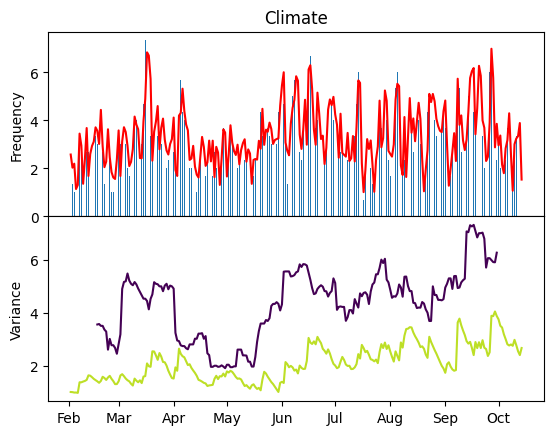

ID2
1
2
3
4
1
1


<Figure size 1600x6400 with 0 Axes>

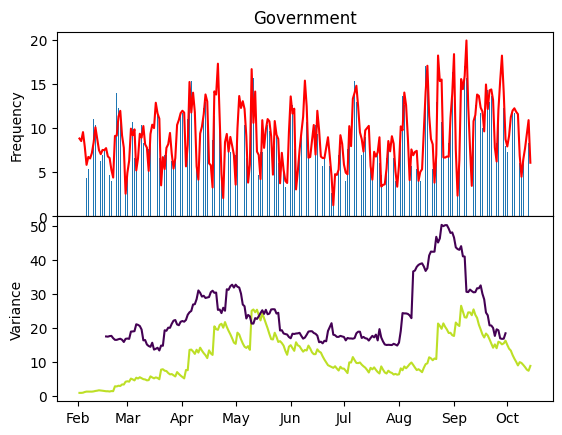

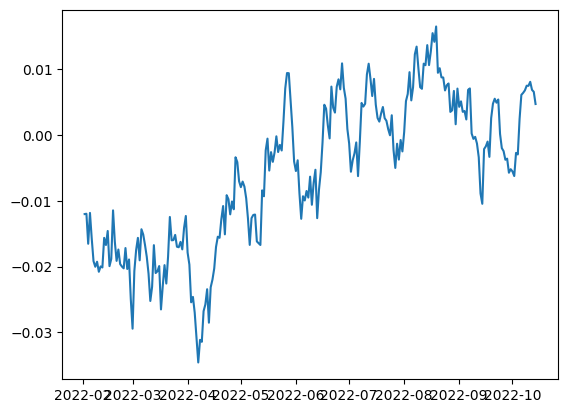

758.0695974826813


In [ ]:
import time
analysis3 = Model()
hi = MonteCarlo(analysis3)
t = time.time()

pt = 0.8
hi.movingaveragemontecarlo('Climate','Government',3,3000,pt,1,0,True)
elapsed = time.time() -t
print(elapsed)

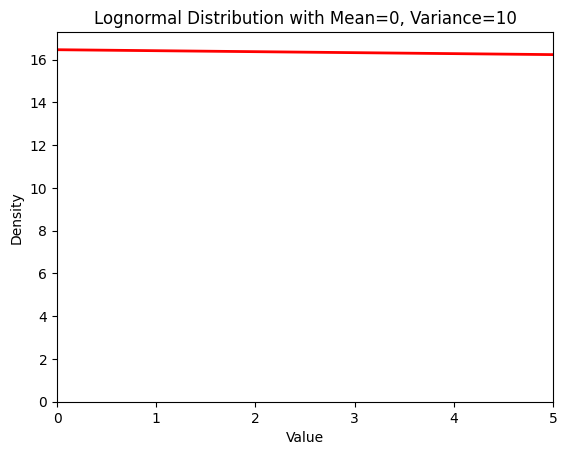

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Set the parameters of the lognormal distribution
mean = 0
variance = 10


# Generate a random sample of 10,000 values from the lognormal distribution
sample = np.random.lognormal(mean, np.sqrt(variance), size=10000)

# Plot a histogram of the sample to visualize the shape of the distribution
plt.hist(sample, bins=50, density=True)

# Compute the corresponding x-values for the lognormal PDF
x = np.linspace(min(sample), max(sample), num=1000)
pdf = np.exp(-(np.log(x) - mean)**2 / (2 * variance)) / (x * np.sqrt(2 * np.pi * variance))

# Plot the lognormal PDF on top of the histogram
plt.plot(x, pdf, linewidth=2, color='r')

# Label the plot
plt.xlim(0,5)
plt.xlabel('Value')
plt.ylabel('Density')
plt.title('Lognormal Distribution with Mean=0, Variance='+str(variance))

# Show the plot
plt.savefig('./Plots/Lognormals/'+str(variance).replace(".","_"))
plt.show()


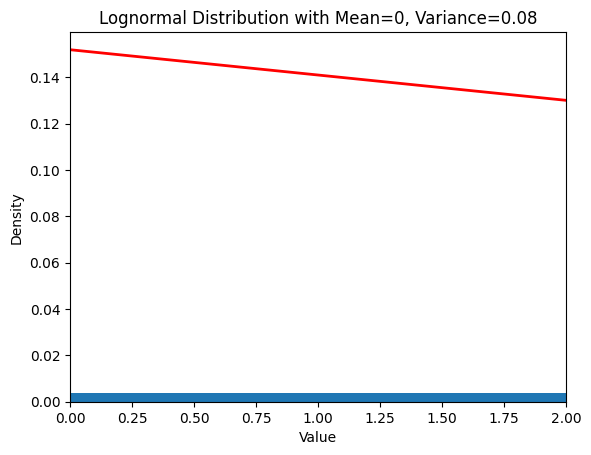

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Set the parameters of the lognormal distribution
mean = 1
variance = 5

# Generate a random sample of 10,000 values from the lognormal distribution
sample = np.random.lognormal(mean, np.sqrt(variance), size=10000)

# Plot a histogram of the sample to visualize the shape of the distribution
plt.hist(sample, bins=50, density=True)

# Compute the corresponding x-values for the lognormal PDF
x = np.linspace(min(sample), max(sample), num=1000)
pdf = np.exp(-(np.log(x) - mean)**2 / (2 * variance)) / (x * np.sqrt(2 * np.pi * variance))

# Plot the lognormal PDF on top of the histogram
plt.plot(x, pdf, linewidth=2, color='r')

# Label the plot
plt.xlim(0,2)
plt.xlabel('Value')
plt.ylabel('Density')
plt.title('Lognormal Distribution with Mean=0, Variance=0.08')

# Show the plot
plt.show()


In [ ]:
class MonteCarlo:
    def __init__(self,analysis):
        self.hi = 2
        self.df = analysis.df
        self.analysis = analysis
        self.SMCstates = {}
        self.smoothdf = pd.DataFrame()

    # state space model - Mutation
    def StateSpace_iplus1_mean(self,xt,v):
        dummy = xt+np.random.normal(0,scale =np.sqrt(v))
        # print('oub: ',dummy)
        while dummy<0:
            dummy = xt+np.random.normal(0,scale =np.sqrt(v))
            
        # print("fixed")
        return(dummy)
        #return(Xt_1 *dnp.random.lognormal(mean=0.0, sigma=1.0)
        #return(Xt_1*np.random.exponential(scale = 1))
    def StateSpace_iplus1_var(self,v,pt):
        return(v*np.random.uniform(0.8,1.2))#np.random.lognormal(mean = 0,sigma = pt))
            
    #Mutation
    def hiddenmodel_iplus1(self,observation,state):
        return(poisson.pmf(observation, mu=state))
    
    def hiddenmodel_i_plus_1_var(self,observation,statemean,statevar):
        return(scipy.stats.norm.pdf(observation,statemean,np.sqrt(statevar)))

    def general_filter(self,obs1,obs2,N,t1,t2,param):
        #ParticleStates = [0 for z in range(len(obs))]
        MeanStates1  = np.zeros((N,len(obs1)))
        VarStates1 = np.zeros((N,len(obs1)))
        MeanIndicies1 = np.zeros((N,len(obs1)))
        VarIndicies1 = np.zeros((N,len(obs1)))

        MeanStates2  = np.zeros((N,len(obs2)))
        VarStates2 = np.zeros((N,len(obs2)))
        MeanIndicies2 = np.zeros((N,len(obs2)))
        VarIndicies2 = np.zeros((N,len(obs2)))
        
        # N is the number of particles for filter
        # oba is our observation vector
        obs1 = np.array(obs1)
        obs2 = np.array(obs2)


        # Initial prior distribution for our unobservable quantity of interest
        initialstate1 = [np.mean(obs1) for i in range(0,N)]
        initialstate2 = [np.mean(obs2) for i in range(0,N)]
        #print(initialstate)

        X = np.zeros((2,N))
        X[0,:] = initialstate1
        X[1,:] = [1 for i in range(N)]
        MeanStates1[:,0] = initialstate1
        MeanIndicies1[:,0] = np.arange(N)
        VarIndicies1[:,0] = np.arange(N)

        Y = np.zeros((2,N))
        Y[0,:] = initialstate2
        Y[1,:] = [1 for i in range(N)]
        MeanStates1[:,0] = initialstate2
        MeanIndicies1[:,0] = np.arange(N)
        VarIndicies1[:,0] = np.arange(N)
        #Store the final rate paramater
        rate1 =np.zeros(len(obs1))
        rate2 = np.zeros(len(obs2))

        for i in range(0,len(obs1)):
            #Give the parameter for our state space model and updated rate 
            # having ovserved our data point Y[i]
            [X,Y,X_est,Imean,Ivar] = self.Filter(X,Y,obs1[i],obs2[i],N,param)
            MeanStates1[:,i] = X[0,:]
            VarStates1[:,i] = X[1,:]
            MeanStates2[:,i] = Y[0,:]
            VarStates2[:,i] = Y[1,:]


            MeanIndicies1[:,i] = Imean
            VarIndicies1[:,i] = Ivar
            rate1[i] = X_est
            print((i+1)*100/(len(obs1)*t1) + t2,'%')
        MeanIndicies = np.rint(MeanIndicies1)
        VarIndicies = np.rint(VarIndicies1)        
        #print(RoundedIndicies.shape)
        return(rate1,MeanStates1,VarStates1,MeanIndicies,VarIndicies)

    def Filter(self,X,Y,obs1,obs2,N,param):
        WeightsX = [0 for i in range(N)]
        Weights1sdX = [0 for i in range(N)]

        WeightsY = [0 for i in range(N)]
        Weights1sdY = [0 for i in range(N)]
        #For each particle in our filter
        #Particles are a 2xN object
        #Draw a sample from our 'proposal distribution' i.e. for computing predictive step
        for i in range(0,N):
            #Mutate firstly
            X[0,i] = self.StateSpace_iplus1_mean(X[0,i],X[1,i])
            X[1,i] = self.StateSpace_iplus1_var(X[1,i],pt=param)

            Y[0,i] = self.StateSpace_iplus1_mean(Y[0,i],Y[1,i])
            Y[1,i] = self.StateSpace_iplus1_var(Y[1,i],pt=param)
            #Compute weights by computing the current likelihood of a particle
            WeightsX[i] = self.hiddenmodel_iplus1(obs1,X[0,i])
            Weights1sdX[i] = self.hiddenmodel_i_plus_1_var(obs1,X[0,i],X[1,i])

            WeightsY[i] = self.hiddenmodel_iplus1(obs2,Y[0,i])
            Weights1sdY[i] = self.hiddenmodel_i_plus_1_var(obs2,Y[0,i],Y[1,i])

        #Normalise weights
        sumW = sum(WeightsX)
        for i in range(N):
            WeightsX[i] = WeightsX[i]/sumW
        sumW1sd = sum(Weights1sdX)
        for i in range(N):
            Weights1sdX[i] = Weights1sdX[i]/sumW1sd
        sumW = sum(WeightsY)
        for i in range(N):
            WeightsY[i] = WeightsY[i]/sumW
        sumW1sd = sum(Weights1sdY)
        for i in range(N):
            Weights1sdY[i] = Weights1sdY[i]/sumW1sd
        #Resample from these weights    

        ImeanX = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = WeightsX)
        IvarX = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = Weights1sdX)

        ImeanY = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = WeightsY)
        IvarY = np.random.choice(list(range(len(X[0,:]))),replace = True, size = N, p = Weights1sdY)
        
        X[0,:] = X[0,ImeanX]
        X[1,:] = X[1,IvarX]

        Y[0,:] = Y[0,ImeanY]
        Y[1,:] = Y[1,IvarY]
        
        #Convert to state space vectors
        Particles_est = sum(X[0,:])/N
        return(X,Y,Particles_est,ImeanX,IvarX)
    
    def movingaveragemontecarlo(self,ID1,ID2,K,N,pt,t1,t2,pltshow = True):
        p_est_dict = {}
        vals = self.df[ID1]
        df_dummy = self.df.copy()
        [rate,MeanStates,VarStates,Imean,Ivar] = self.general_filter(self.df[ID1],self.df[ID2],N,t1,t2,pt)
        #self.SMCstates[ID] = Indicies
        #np.savetxt("States.txt",Indicies , delimiter=",")
        variances = np.mean(VarStates,axis = 0)
        #dfp.rolling(7, center=True).mean()
        hi = pd.DataFrame(vals)
        dude = pd.DataFrame(hi).rolling(K, center=True).mean()        
        dudevar = pd.DataFrame(hi).rolling(30, center=True).var()  
        
        df_dummy['Plottingrate'] = rate
        if pltshow == True:
            ID=ID1
            figure(figsize=(5, 20), dpi=320)
            fig, ax = plt.subplots(nrows = 2, ncols  =1, sharex = True, sharey = False)
            plt.subplots_adjust(hspace = 0)
            ax[0].plot(self.df.index.values,df_dummy['Plottingrate'], color = 'red')
            ax[0].bar(self.df.index.values, dude[ID] ,width = 0.3)
            ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
            ax[0].set_xlabel('Date')
            ax[0].title.set_text(ID)
            ax[0].set_ylabel('Frequency')
            
            #ax2 = ax.twinx()
            #widthintervals = [0.1 + 0.2*(np.log10(changeinvar[i])) for i in range(0,255)]#np.log(cinvar[-1])#initialwidth*np.abs(cinvar[-1]-1)
            ax[1].plot(self.df.index.values,variances,label = 'widths',color = plt.cm.viridis(.9))
            ax[1].plot(self.df.index.values,dudevar[ID1],label = 'widths',color = plt.cm.viridis(0))
            ax[1].set_ylabel('Variance')
            #plt.savefig('./Plots/SMC_dyn_interval/'+ID)
            #ax[1].set_ylim(top = 1)
            plt.show()
        return(MeanStates,VarStates,Imean,Ivar)

In [ ]:
lambda = 0.19
beta = 0.12

print(lambda*np.exp())

In [ ]:
np.dot(a,b.T)

0.1198631230286388

2.82 seconds - 100 Particles
25 seconds - 1000 Particles
50 seconds - 2000 Particles

In [ ]:
import time
analysis3 = Model()
hi = MonteCarlo(analysis3)
t = time.time()
for k in range(1,5):
    pt = 0.01 + k/10
    hi.movingaveragemontecarlo('Climate','Government',3,100,pt,1,0,True)
elapsed = time.time() -t
print(elapsed)

df2:  ['Link', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'Date', 'b26']
['Link', 'Racism', 'Sexual minorities', 'Gender minorities', 'Homosexuality', 'Homophobia', 'Misogyny', 'Intersectionality', 'Toxic', 'Woke', 'Cancel', 'Gender roles', 'Gender identity', 'Feminism', 'Masculinity', 'Other gender', 'Discrimination', 'Equality', 'Rainbow', 'Prime Minister', 'Government', 'Parliament', 'Agriculture', 'Industry', 'Climate', 'Date', 'a26', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'b26']
Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binom

UnboundLocalError: cannot access local variable 'MeanIndicies' where it is not associated with a value

In [ ]:
import time
analysis3 = Model()
hi = MonteCarlo(analysis3)
t = time.time()
for k in range(1,5):
    pt = 0.01 + k/10
    hi.movingaveragemontecarlo('Climate','Government',3,100,pt,1,0,True)
elapsed = time.time() -t
print(elapsed)

df2:  ['Link', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'Date', 'b26']
['Link', 'Racism', 'Sexual minorities', 'Gender minorities', 'Homosexuality', 'Homophobia', 'Misogyny', 'Intersectionality', 'Toxic', 'Woke', 'Cancel', 'Gender roles', 'Gender identity', 'Feminism', 'Masculinity', 'Other gender', 'Discrimination', 'Equality', 'Rainbow', 'Prime Minister', 'Government', 'Parliament', 'Agriculture', 'Industry', 'Climate', 'Date', 'a26', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'b26']
Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binom

UnboundLocalError: cannot access local variable 'MeanIndicies' where it is not associated with a value

In [ ]:
pt = 0.5

Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities
0.39215686274509803 %
0.7843137254901961 %
1.1764705882352942 %
1.5686274509803921 %
1.9607843137254901 %
2.3529411764705883 %
2.7450980392156863 %
3.1372549019607843 %
3.5294117647058822 %
3.9215686274509802 %
4.313725490196078 %
4.705882352941177 %
5.098039215686274 %
5.490196078431373 %
5.882352941176471 %
6.2745098039215685 %
6.666666666666667 %
7.0588235294117645 %
7.450980392156863 %
7.8431372549019605 %
8.235294117647058 %
8.627450980392156 %
9.019607843137255 %
9.411764705882353 %
9.803921568627452 %
10.196078431372548 %
10.588235294117647 %
10.980392156862745 %
11.372549019607844 %
11.764705882352942 %
12.156862745098039 %
12.549019607843137 %
12.941176470588236 %
13.333333333333334 %
13.72549019607843 %
14.117647058823529 %
14.509803921568627 

<Figure size 3200x6400 with 0 Axes>

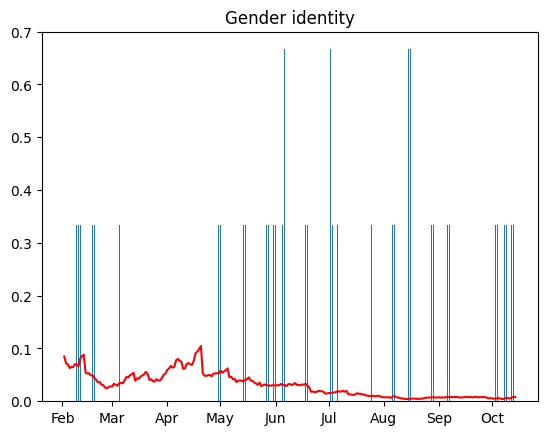

In [ ]:
analysis3 = Model()
hi = MonteCarlo(analysis3)

IDs = list(analysis3.df)
[States,Indicies] = hi.movingaveragemontecarlo('Gender identity',3,5,1,0)


In [ ]:
States.shape[0]

5

In [ ]:
with open('matoutput.txt','w') as file:
    for i in range(States.shape[0]):
        file.write(str(States[i,-5:]))
        file.write('\n')

    file.write('\n')
    for i in range(Indicies.shape[0]):
        file.write(str(Indicies[i,-5:]))
        file.write('\n')

# Computing the Smoother using Poormans

In [ ]:
States

array([[0.10583051, 0.0907415 , 0.05961752, ..., 0.04892531, 0.07296158,
        0.03809005],
       [0.08830754, 0.07123759, 0.07448835, ..., 0.10158698, 0.03246543,
        0.08041912],
       [0.08830754, 0.07408065, 0.0989948 , ..., 0.03833178, 0.03972095,
        0.04205411],
       ...,
       [0.08151443, 0.09306213, 0.1002298 , ..., 0.0866282 , 0.11536887,
        0.04205411],
       [0.10583051, 0.09306213, 0.08491812, ..., 0.11742314, 0.11536887,
        0.04205411],
       [0.08151443, 0.0907415 , 0.08491812, ..., 0.03468602, 0.03611385,
        0.13381291]])

In [ ]:
def get_ancestry(States,Indicies):
    trajectory_ind = np.zeros(Indicies.shape[1])
    trajectory_states = np.zeros(Indicies.shape[1])
    index =0
    
    for i in reversed(range(0,Indicies.shape[1])):
        #index before:
        trajectory_states[i] = States[index,i]

        index = int(Indicies[index,i])
        trajectory_ind[i] = index
        print(index)
    return(trajectory_states, trajectory_ind)


## Implemetation of Poor Man's Smoother:

In [ ]:
hi = MonteCarlo(analysis3)

In [ ]:
import pickle

In [ ]:
analysis3 = Model()
df = analysis3.df
storeageofstates = df.copy
Accuracy = 35
IDs = list(analysis3.df)
state_dict_mean = {}
state_dict_var = {}
pltshow = False
for ID  in IDs:
    print('Smoother for ', ID)
    Ancestry_matrix_mean = np.zeros((Accuracy,len(analysis3.df[ID])))
    Ancestry_matrix_var = np.zeros((Accuracy,len(analysis3.df[ID])))
    hi = MonteCarlo(analysis3)
    for i in range(Accuracy):

        #[States,Indicies] = hi.movingaveragemontecarlo(ID,3,1500,t1 = (Accuracy)) 
        [rate,MeanStates,VarStates,MeanIndicies,VarIndicies] = hi.general_filter(analysis3.df[ID],N = 1000,t1 = Accuracy,t2 = 100*i/(Accuracy), param = 0.5)
        
        #(Particles,Particles_est,Imean,Ivar)
        #Accuracy *len(IDs) for global percentage counter
        [Ancestry_matrix_mean[i,:],h] = get_ancestry(MeanStates,MeanIndicies)
        [Ancestry_matrix_var[i,:],h] = get_ancestry(VarStates,VarIndicies)



        print('\n', int(100*(i+1)/Accuracy),'% SMCs.')
    
    state_dict_mean[ID] = Ancestry_matrix_mean
    state_dict_var[ID] = Ancestry_matrix_var

    with open('multpoisvar_meanstates.pickle', 'wb') as meanfile:
        pickle.dump(state_dict_mean,meanfile,protocol = pickle.HIGHEST_PROTOCOL)
    with open('multpoisvar_varstates.pickle','wb') as varfile:
        pickle.dump(state_dict_var,varfile,protocol=pickle.HIGHEST_PROTOCOL)

    if pltshow == True:
        arr_mean = state_dict_mean[ID]
        arr_var = state_dict_var[ID]

        smoothed_data_mean = np.zeros(arr_mean.shape[1])
        smoothed_data_var = np.zeros(arr_var.shape[1])
        for i in range(arr_mean.shape[1]):
            smoothed_data_mean[i] = np.mean(arr_mean[:,i])
            smoothed_data_var[i] = np.mean(arr_var[:,i])
        
        #storeageofstates[ID] = list(smoothed_data)
        #storeageofstates.to_csv('storesmoothedstates.csv')
        vals = df[ID]
        df_dummy = df.copy()
        # [rate,ParticleStates,Indicies] = self.general_filter(self.df[ID],N)
        # self.SMCstates[ID] = Indicies
        #np.savetxt("States.txt",Indicies , delimiter=",")

        #dfp.rolling(7, center=True).mean()
        hi = pd.DataFrame(vals)
        dude = pd.DataFrame(hi).rolling(3, center=True).mean()        

        df_dummy['Plottingrate'] = smoothed_data
        figure(figsize=(10, 20), dpi=320)
        fig, ax = plt.subplots()
        plt.plot(df.index.values,df_dummy['Plottingrate'], color = 'red')
        ax.bar(df.index.values, dude[ID] ,width = 0.3)
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
        plt.title(ID)
        plt.savefig('./Plots/SmoothedSMC/'+ID)
        plt.show()

df2:  ['Link', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'Date', 'b26']
['Link', 'Racism', 'Sexual minorities', 'Gender minorities', 'Homosexuality', 'Homophobia', 'Misogyny', 'Intersectionality', 'Toxic', 'Woke', 'Cancel', 'Gender roles', 'Gender identity', 'Feminism', 'Masculinity', 'Other gender', 'Discrimination', 'Equality', 'Rainbow', 'Prime Minister', 'Government', 'Parliament', 'Agriculture', 'Industry', 'Climate', 'Date', 'a26', 'Elderly', 'Secretary of Treasury', 'Act Proposal', 'School', 'Labor Unions', 'Secretary of Defence', 'Secretary of Foreign Affairs', 'Mortgage', 'Demonstrations', 'Immigration', 'Secretary of State Home Office', 'b26']
Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binom

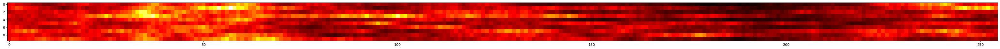

In [ ]:
a = state_dict['Racism']
import matplotlib.pyplot as plt
import numpy as np
figure(figsize=(50, 255), dpi=80)
plt.imshow(a, cmap='hot', interpolation='nearest')
plt.show()

<Figure size 3200x6400 with 0 Axes>

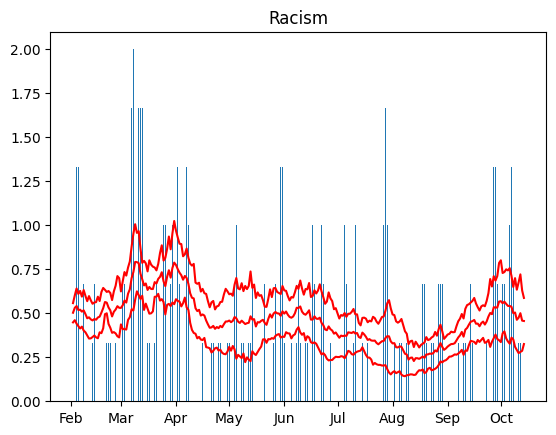

In [ ]:
ID = 'Racism'
arr = state_dict[ID]
arr_std = np.zeros(arr.shape[1])
arr_mean = np.zeros(arr.shape[1])
for i in range(arr.shape[1]):
    arr_std[i] = np.std(arr[:,i])
    arr_mean[i] = np.mean(arr[:,i])
ylower = arr_mean - arr_std
yupper = arr_mean + arr_std
ymiddle = arr_mean

df = analysis3.df
vals = df[ID]
df_dummy = df.copy()
# [rate,ParticleStates,Indicies] = self.general_filter(self.df[ID],N)
# self.SMCstates[ID] = Indicies
#np.savetxt("States.txt",Indicies , delimiter=",")

#dfp.rolling(7, center=True).mean()
hi = pd.DataFrame(vals)
dude = pd.DataFrame(hi).rolling(3, center=True).mean()    
figure(figsize=(10, 20), dpi=320)
fig, ax = plt.subplots()
plt.plot(df.index.values,ylower, color = 'red')
plt.plot(df.index.values,yupper, color = 'red')
plt.plot(df.index.values,ymiddle, color = 'red')
ax.bar(df.index.values, dude[ID] ,width = 0.3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
plt.title(ID)
#plt.savefig('./Plots/SMC/'+ID)
plt.show()

In [ ]:
import pickle

with open('filename.pickle', 'wb') as handle:
    pickle.dump(state_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
arr = state_dict['Climate']
smoothed_data = np.zeros(arr.shape[1])
for i in range(arr.shape[1]):
    smoothed_data[i] = np.mean(arr[:,i])


KeyError: 'Climate'

<Figure size 3200x6400 with 0 Axes>

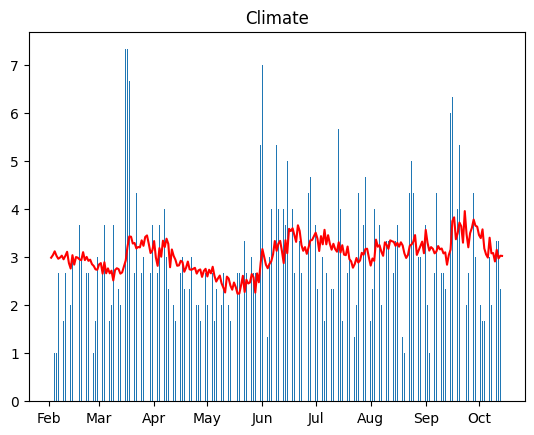

In [ ]:
ID = 'Climate'
df = analysis3.df
vals = df[ID]
df_dummy = df.copy()
# [rate,ParticleStates,Indicies] = self.general_filter(self.df[ID],N)
# self.SMCstates[ID] = Indicies
#np.savetxt("States.txt",Indicies , delimiter=",")

#dfp.rolling(7, center=True).mean()
hi = pd.DataFrame(vals)
dude = pd.DataFrame(hi).rolling(3, center=True).mean()        

df_dummy['Plottingrate'] = smoothed_data
figure(figsize=(10, 20), dpi=320)
fig, ax = plt.subplots()
plt.plot(df.index.values,df_dummy['Plottingrate'], color = 'red')
ax.bar(df.index.values, dude[ID] ,width = 0.3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b')) # Only plot the month
plt.title(ID)
#plt.savefig('./Plots/SMC/'+ID)
plt.show()

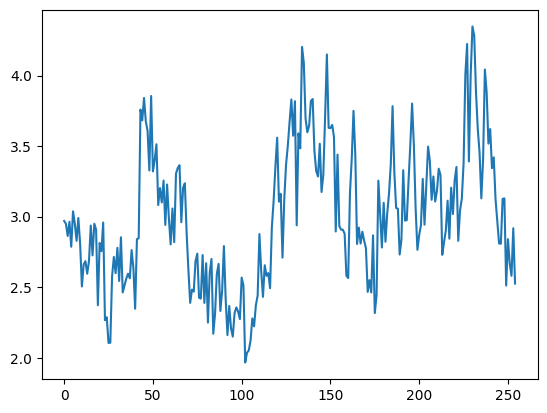

In [ ]:
plt.plot(smoothed_data)

In [ ]:

mat = hi.SMCstates['Climate']
target = mat[0,-1]
target_arr = []
target_arr.append(target)
for j in reversed(range(len(mat[0,:])-1)):
    s_slice = mat[:,j]
    index = np.where(s_slice == target)
    print(index)
    target = s_slice[index]
    target_arr.append(target) 

(array([67], dtype=int64),)
(array([16, 41], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(arr

C:\Users\kianv\AppData\Local\Temp\ipykernel_11292\3336059819.py:7: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  index = np.where(s_slice ==target)


In [ ]:
list(analysis3.df)

['Racism',
 'Sexual minorities',
 'Gender minorities',
 'Homosexuality',
 'Homophobia',
 'Misogyny',
 'Intersectionality',
 'Toxic',
 'Woke',
 'Cancel',
 'Gender roles',
 'Gender identity',
 'Feminism',
 'Masculinity',
 'Other gender',
 'Discrimination',
 'Equality',
 'Rainbow',
 'Prime Minister',
 'Government',
 'Parliament',
 'Agriculture',
 'Industry',
 'Climate',
 'NumOfArticles']

In [ ]:
target_arr

[76.0,
 array([76.]),
 array([76.]),
 array([76., 76.]),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64),
 array([], dtype=float64)

25.0

In [ ]:
target

76.0

In [ ]:
States[0,0].dtype

dtype('float64')

In [ ]:
np.random.uniform(low = 0, high = 1/5)

0.1945575707079632

In [ ]:
hashmap = {}

In [ ]:
def resampling_algorithm_from_article(X0,W0):
    X1 = [0 for i in range(len(X0))]
    W1 = [0 for i in range(len(W0))]
    CDF = np.cumsum(W0)
    i=0 #start at bottom of CDF
    u0 = np.random.uniform(low = 0, high = 1/len(X0))
    for j in range(len(X0)):
        u1 = u0 + (1/len(X0))*j
        while u1>CDF[i]:
            i+=1
        X1[j] = X0[i]
        W1[j] = (len(X0))**-1
    return(X1,W1)


In [ ]:
def resampling_tester(resamplingmethodfunc): 
    X0 = [1,2,5]
    W0 = [0.1,0.8,0.1]
    numsimulations = 1000
    hashmap = {}
    for i in range(numsimulations):
        [X1,W1] = resamplingmethodfunc(X0,W0)

        #Count number of particles of specific type per iteration
        for elem in X1:
            if elem in hashmap:
                hashmap[elem] +=1
            else:
                hashmap[elem] = 1

    #Plot the probabilities. We would expect that this would align with W0 since repeated resampling from the pdf {X0,W0}
    dictvalues = np.array(list(hashmap.values()))
    plt.bar(hashmap.keys(),dictvalues/sum(dictvalues))


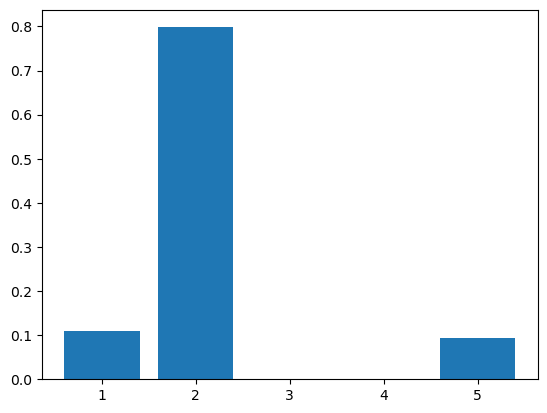

In [ ]:
resampling_tester(resampling_algorithm_from_article)

0.06462015752010952
0.39795349085344284
0.7312868241867762


<BarContainer object of 2 artists>

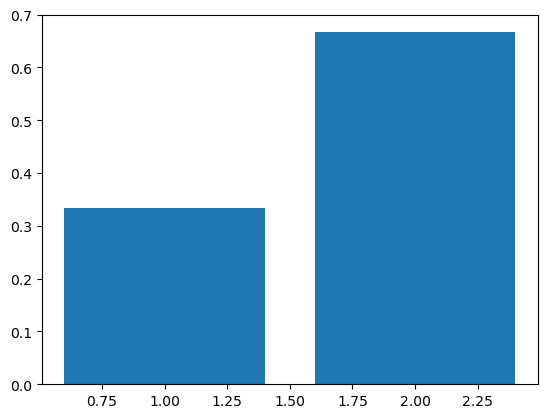

In [ ]:
X1 = [1,2,5]
W1 = [0.1,0.8,0.1]
CDF = np.cumsum(W1)
hashmap = {}
i=0 #start at bottom of CDF
u0 = np.random.uniform(low = 0, high = 1/len(X1))
for j in range(len(X1)):
    u1 = u0 + (1/len(X1))*j
    print(u1)
    while u1>CDF[i]:
        i+=1
    X1[j] = X1[i]
    W1[j] = (len(X1))**-1

for elem in X1:
    if elem in hashmap:
        hashmap[elem] +=1
    else:
        hashmap[elem] = 1
dictvalues = np.array(list(hashmap.values()))
plt.bar(hashmap.keys(),dictvalues/sum(dictvalues))


In [ ]:
X1

[2, 2, 2]

In [ ]:
[4,8]/sum(list(hashmap.values()))

TypeError: unsupported operand type(s) for /: 'list' and 'int'

In [ ]:
hashmap.keys()

dict_keys([2, 5])

Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities


<Figure size 3200x6400 with 0 Axes>

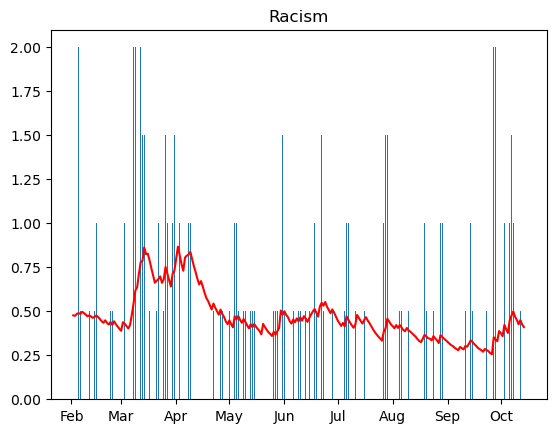

<Figure size 3200x6400 with 0 Axes>

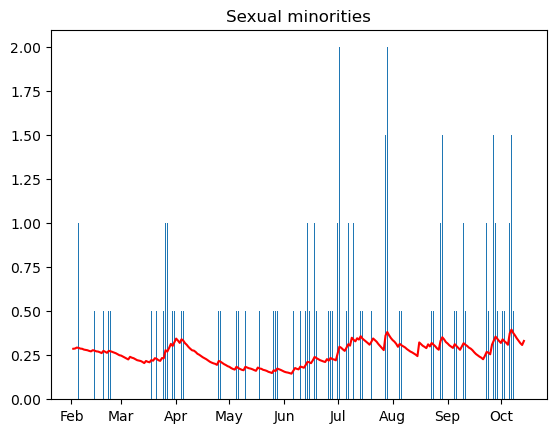

<Figure size 3200x6400 with 0 Axes>

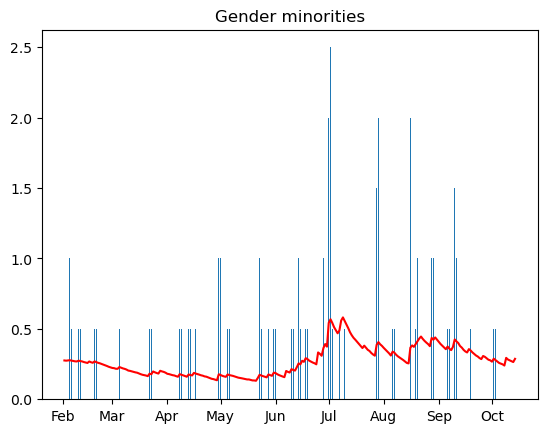

<Figure size 3200x6400 with 0 Axes>

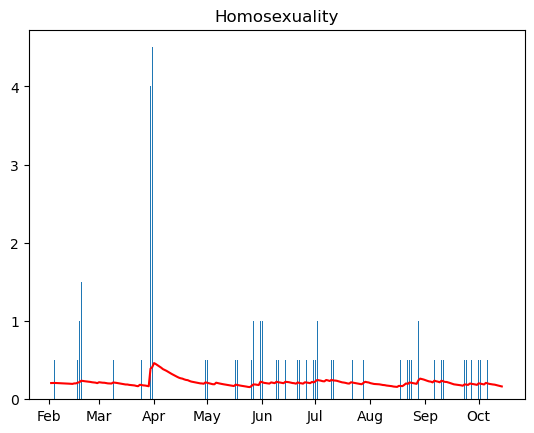

<Figure size 3200x6400 with 0 Axes>

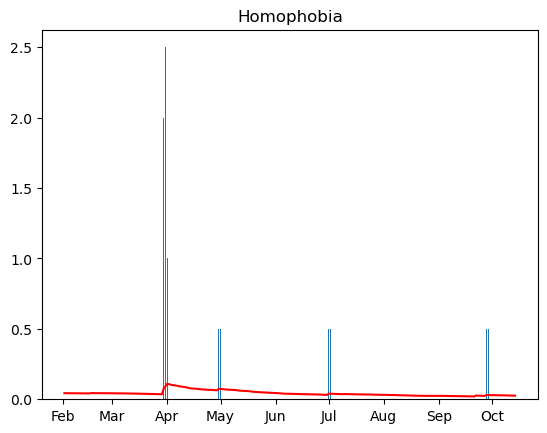

<Figure size 3200x6400 with 0 Axes>

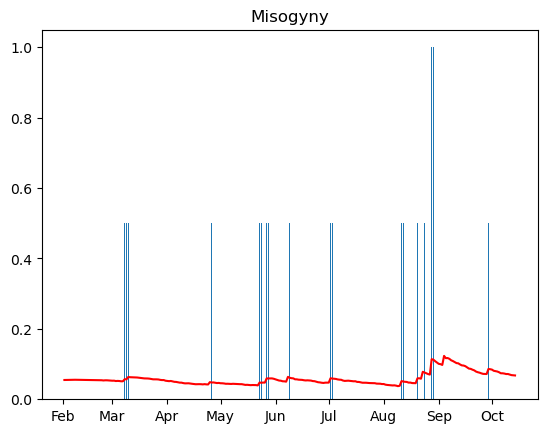

<Figure size 3200x6400 with 0 Axes>

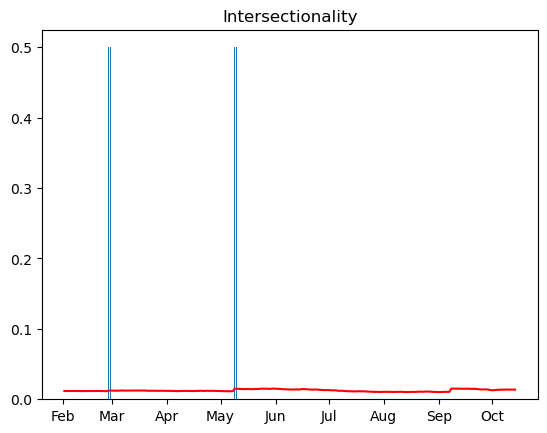

<Figure size 3200x6400 with 0 Axes>

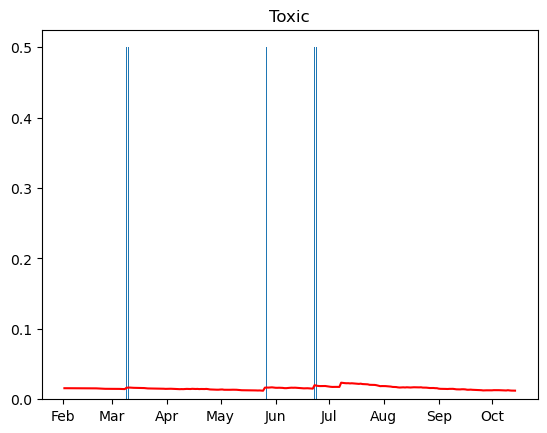

<Figure size 3200x6400 with 0 Axes>

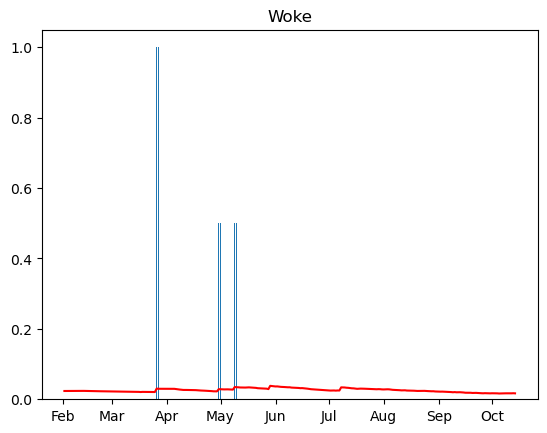

<Figure size 3200x6400 with 0 Axes>

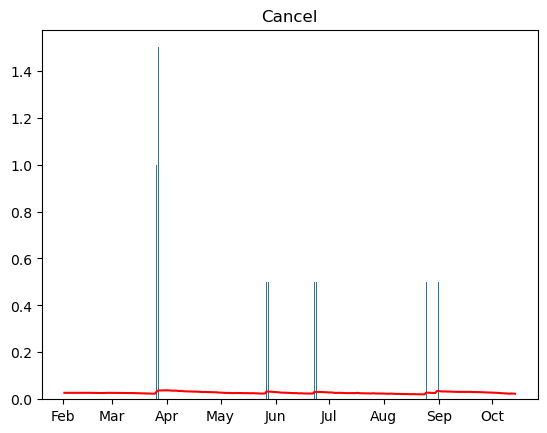

<Figure size 3200x6400 with 0 Axes>

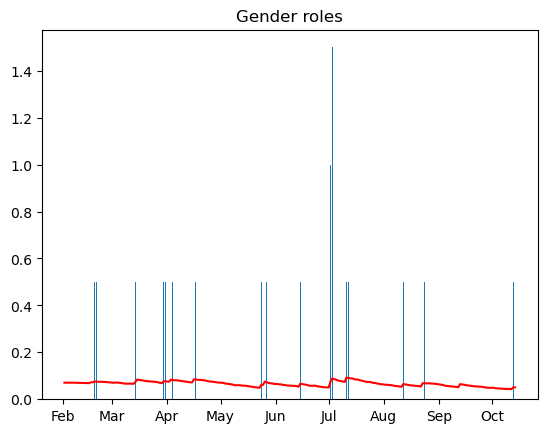

<Figure size 3200x6400 with 0 Axes>

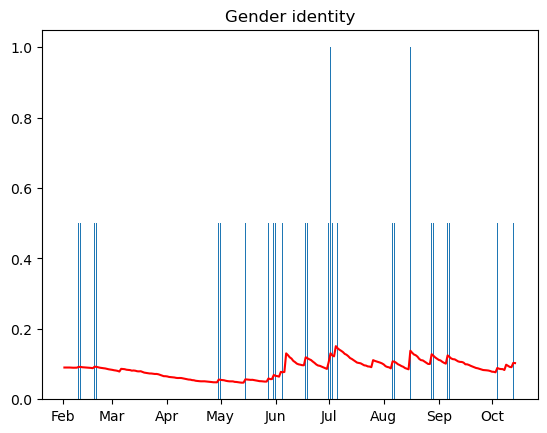

<Figure size 3200x6400 with 0 Axes>

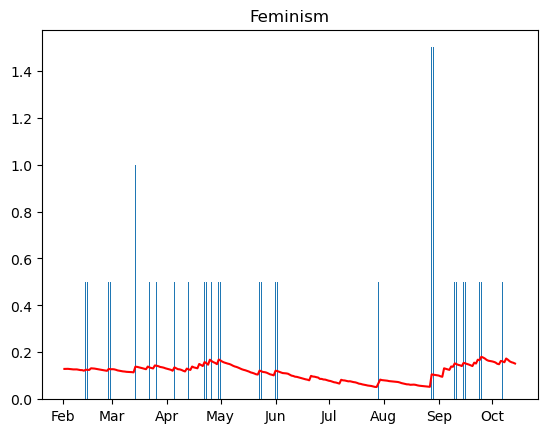

<Figure size 3200x6400 with 0 Axes>

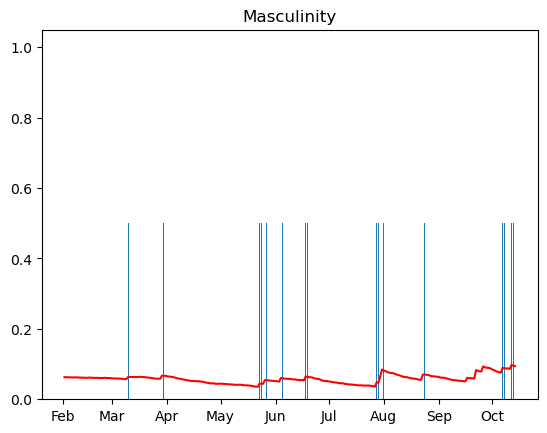

<Figure size 3200x6400 with 0 Axes>

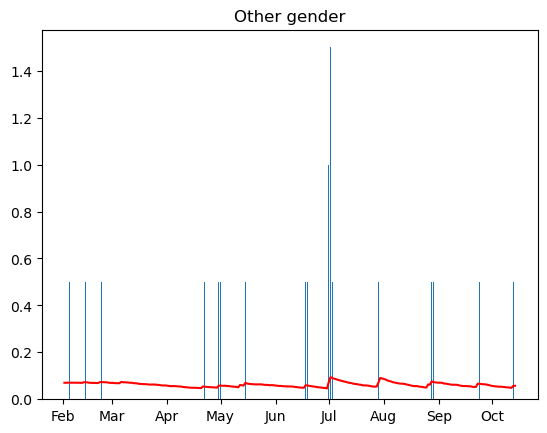

<Figure size 3200x6400 with 0 Axes>

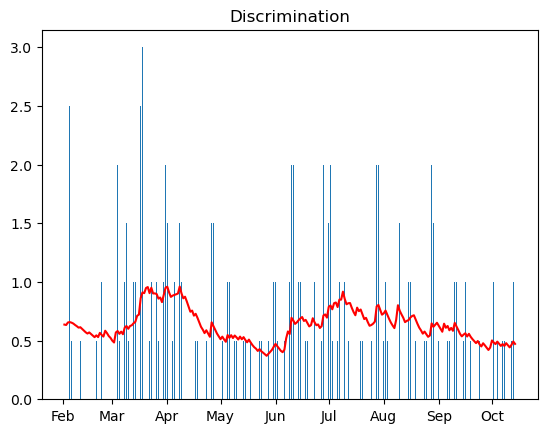

<Figure size 3200x6400 with 0 Axes>

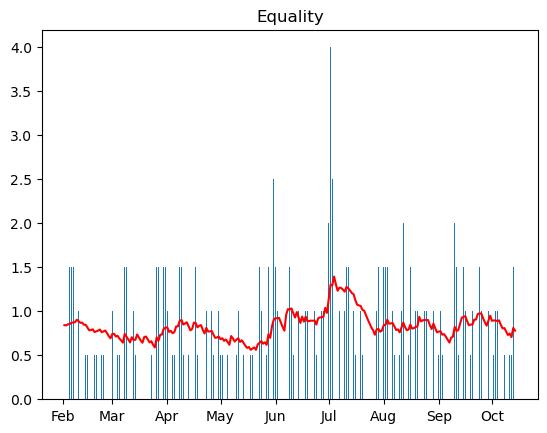

<Figure size 3200x6400 with 0 Axes>

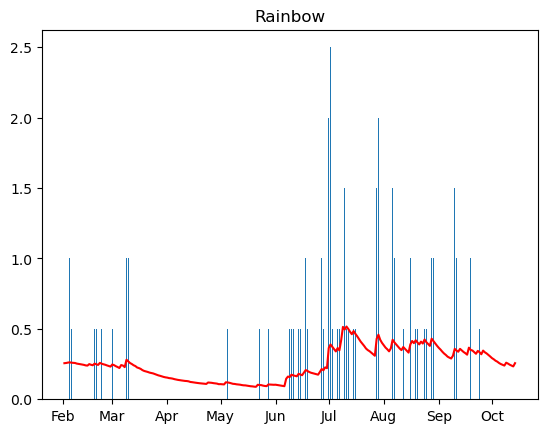

<Figure size 3200x6400 with 0 Axes>

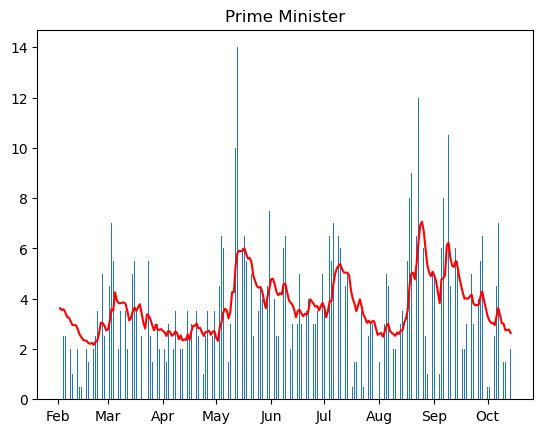

<Figure size 3200x6400 with 0 Axes>

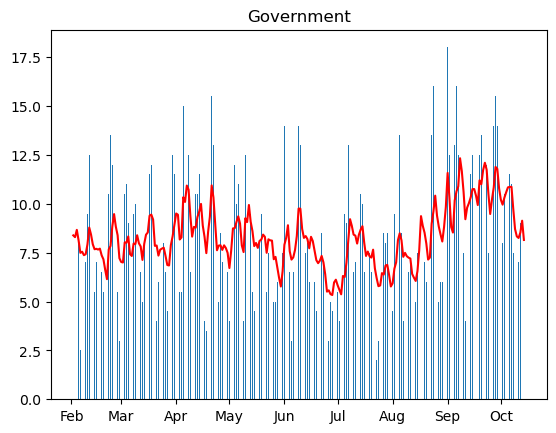

<Figure size 3200x6400 with 0 Axes>

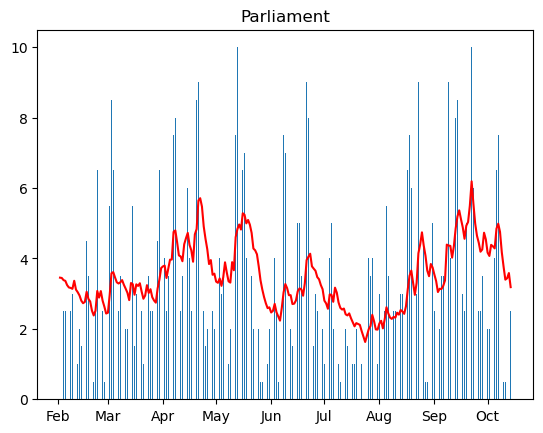

<Figure size 3200x6400 with 0 Axes>

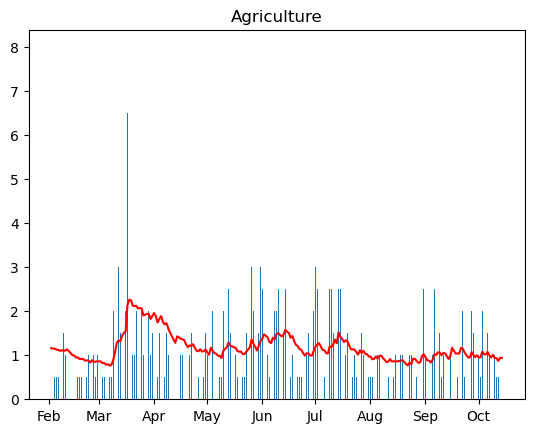

<Figure size 3200x6400 with 0 Axes>

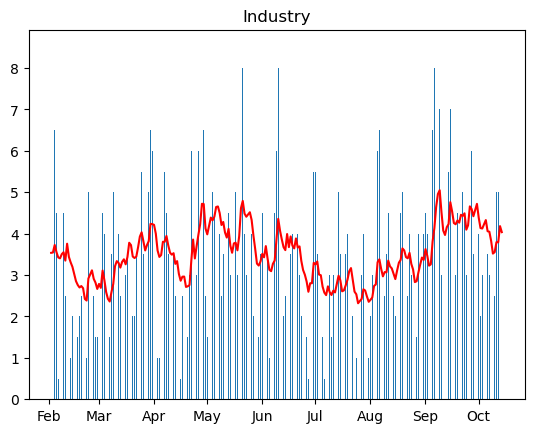

<Figure size 3200x6400 with 0 Axes>

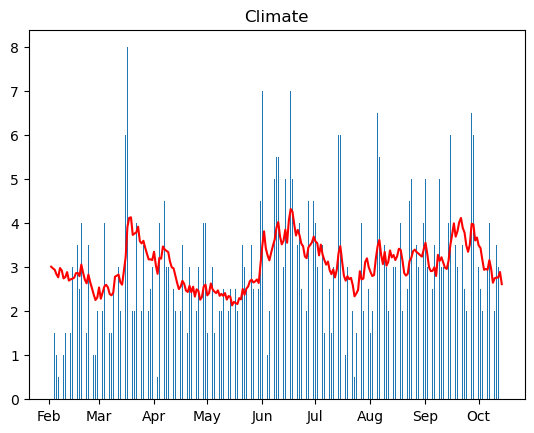

<Figure size 3200x6400 with 0 Axes>

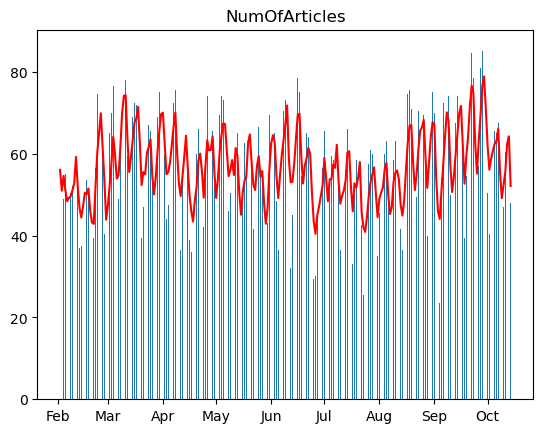

In [ ]:
analysis3 = Model()
hi = MonteCarlo(analysis3)

IDs = list(analysis3.df)
for ID in IDs:
    hi.movingaveragemontecarlo(ID,2,2100)


In [ ]:
import numpy as np
import scipy

In [ ]:
numpart = 1000
X0 = [np.random.uniform(low = 0,high = 1) for i in range(numpart)]
W0 = [scipy.stats.poisson.pmf(k = 0.5, mu = particle) for particle in X0 ]

In [ ]:
def montecarlo(X0,W0, obs):
    X1 = [elem*np.random.uniform(low = 0.9, high = 1.1) for elem in X0] # Evolve according to our state model
    W1 = [scipy.stats.poisson.pmf(k = obs, mu = x) for x in X1]
    
    Wsum = sum(W1)
    W1 = [elem/Wsum for elem in W1]
    
    #Resampling
    [X1,W1] = resampling_algorithm_from_article(X1,W1)
    #X_resampled = X1[np.random.rand(1,len(X1)).astype(int)]
    return(X1,W1)


In [ ]:
#Apply SMC:
numpart = 100
X0 = [np.random.uniform(low = 0,high = 1) for i in range(numpart)]
W0 = [scipy.stats.poisson.pmf(k = 0.5, mu = particle) for particle in X0 ]
analysis3 = Model()
obs_arr = list(analysis3.df['Climate'])
States = [[0,0,0] for i in range(len(obs_arr))]

num_steps = len(obs_arr)
for i in range(num_steps):
    [X1,W1] = montecarlo(X0,W0,obs_arr[i])
    States[i] = [X1,W1,sum(X1)/numpart]

Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities


In [ ]:
means = [elem[2] for elem in States]
states = [elem[0] for elem in States]

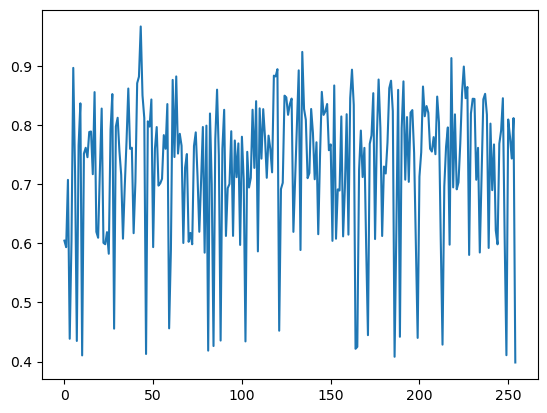

In [ ]:
plt.plot(means)
# plt.plot(obs_arr)
plt.show()

0.013696183213660654
0.347029516546994
0.6803628498803272


<BarContainer object of 2 artists>

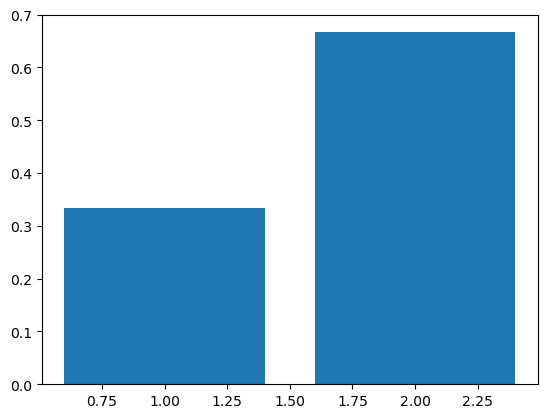

In [ ]:
X1 = [1,2,5]
W1 = [0.1,0.8,0.1]
CDF = np.cumsum(W1)
hashmap = {}
i=0 #start at bottom of CDF
u0 = np.random.uniform(low = 0, high = 1/len(X1))
for j in range(len(X1)):
    u1 = u0 + (1/len(X1))*j
    print(u1)
    while u1>CDF[i]:
        i+=1
    X1[j] = X1[i]
    W1[j] = (len(X1))**-1

for elem in X1:
    if elem in hashmap:
        hashmap[elem] +=1
    else:
        hashmap[elem] = 1
dictvalues = np.array(list(hashmap.values()))
plt.bar(hashmap.keys(),dictvalues/sum(dictvalues))


In [ ]:
W = np.empty
Wcum = [3.21988384e-06, 5.15158333e-06, 8.34006083e-06, 1.13205615e-05,
 1.33533225e-05, 1.65455336e-05, 1.84987392e-05, 2.02658908e-05,
 2.35050316e-05, 2.58412900e-05]
W1 = [3.219883836744817e-06, 1.931699496627953e-06, 3.188477491698452e-06, 2.980500664663744e-06, 2.0327609701865217e-06, 3.1922111213601873e-06, 
1.9532055886797005e-06, 1.7671516496215926e-06, 3.2391407392647513e-06, 2.3362584654220274e-06]
np.searchsorted(Wcum,np.random.rand(len(W1))).tolist()

[10, 10, 10, 10, 10, 10, 10, 10, 10, 10]

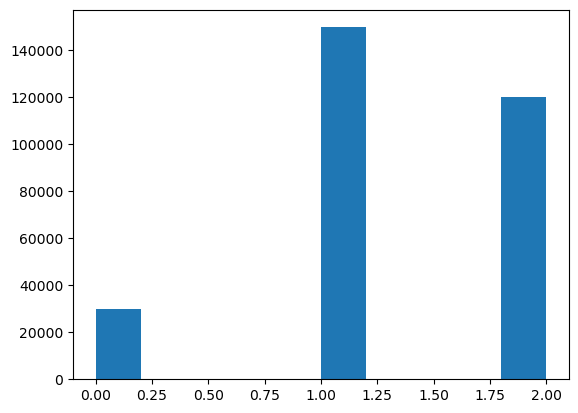

In [ ]:
W = [0.1,0.5,0.4]
Wcum = np.cumsum(W)
I = []
for i in range(100000):
    E = np.searchsorted(Wcum,np.random.rand(3)).tolist()
    I=I+E
plt.hist(I)
plt.show()
    

<BarContainer object of 3 artists>

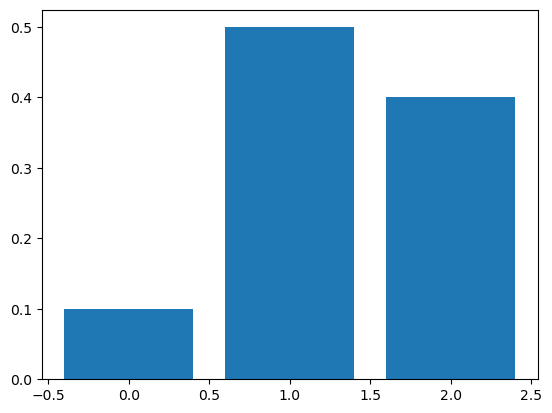

In [ ]:
Isum = sum(I)
T = [I[i]/Isum for i in range(len(I)) ]
hashmap = {}
for elem in I:
    if elem in hashmap:
        hashmap[elem] +=1
    else:
        hashmap[elem] = 1
Isum = sum(hashmap.values())
for elem in hashmap:
    hashmap[elem] = hashmap[elem]/Isum

plt.bar(hashmap.keys(),hashmap.values())

In [ ]:
hashmap

{1: 149832, 2: 120152, 0: 30016}

In [ ]:
#Apply SMC:
numpart = 100
X0 = [5+np.random.uniform(low = 0,high = 1) for i in range(numpart)]
W0 = [scipy.stats.poisson.pmf(k = 0.5, mu = particle) for particle in X0 ]
analysis3 = Model()
obs_arr = list(analysis3.df['Homophobia'])
States = [[0,0,0] for i in range(len(obs_arr))]

num_steps = len(obs_arr)
for i in range(num_steps):
    [X1,W1] = montecarlo(X0,W0,obs_arr[i])
    States[i] = [X1,W1,sum(X1)/numpart]

Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities


In [ ]:
means = [elem[2] for elem in States]
states = [elem[0] for elem in States]

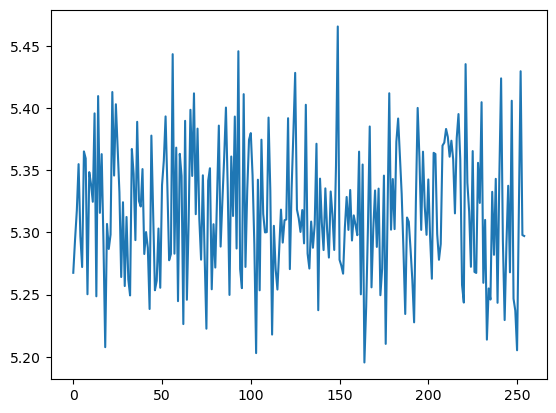

In [ ]:
plt.plot(means)

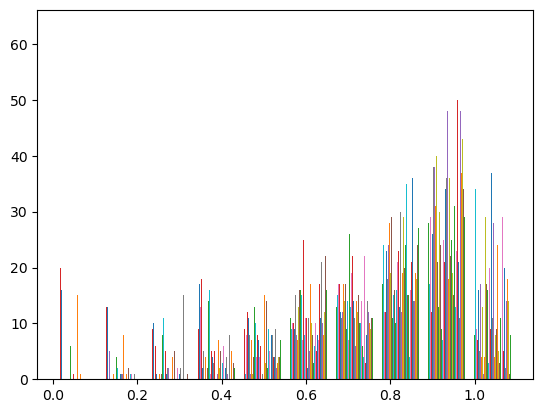

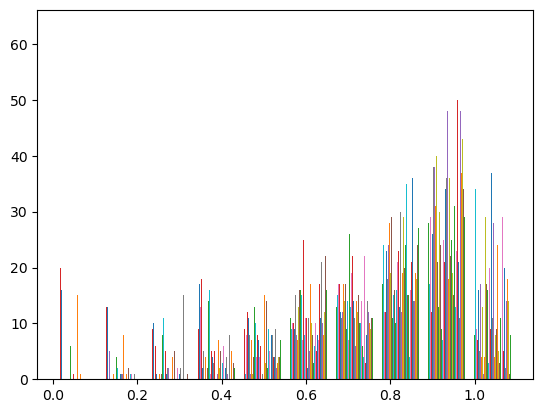

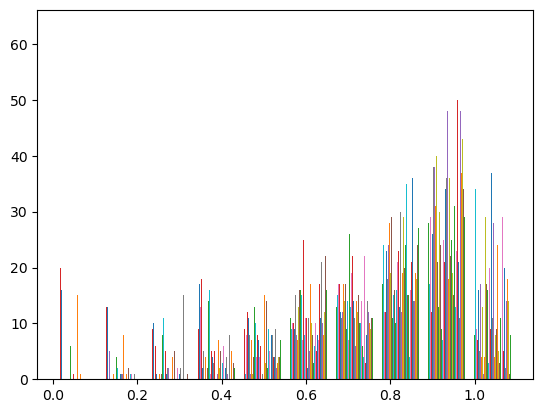

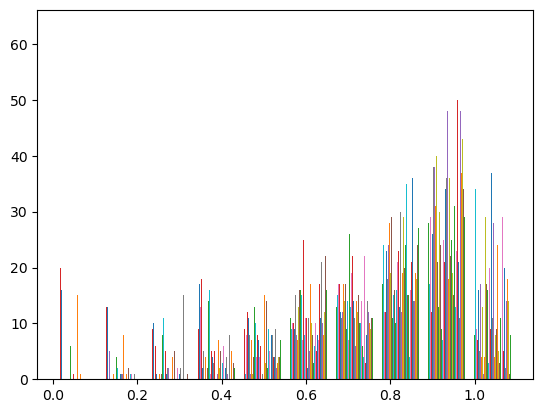

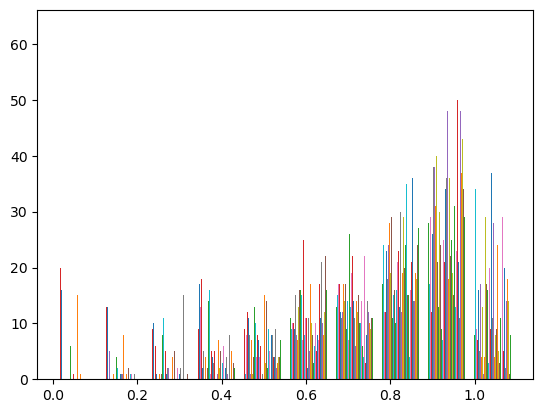

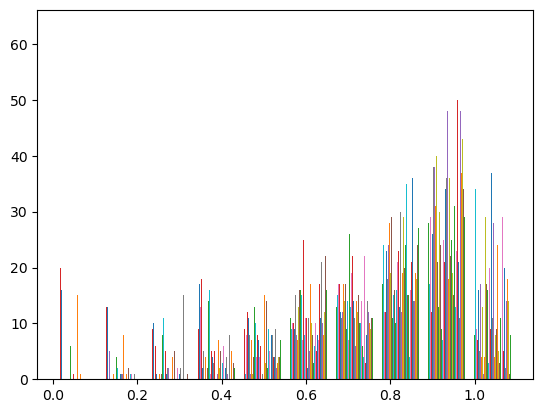

KeyboardInterrupt: 

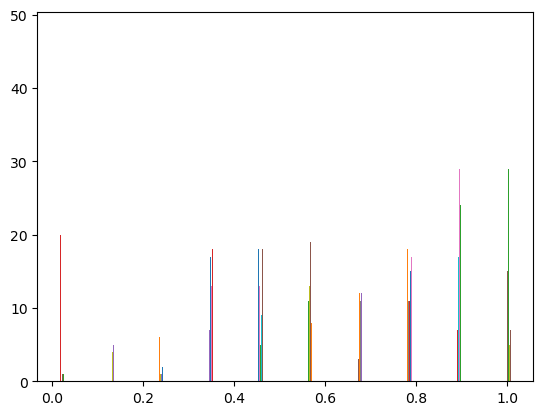

In [ ]:
import time
for i in range(0,len(states),5):
    figure()
    plt.hist(states)
    plt.show()
    time.sleep(0.1)

In [ ]:
means

[0.621035918902106,
 0.6189952867047382,
 0.709138850649759,
 0.43428486283292833,
 0.5954909144464348,
 0.8958944073529296,
 0.7104188094915392,
 0.37608014798959305,
 0.7824984457965853,
 0.8384623840112355,
 0.4342657186041394,
 0.7663827493724139,
 0.7395535478738807,
 0.7588741245194118,
 0.7792159482046958,
 0.7236779855972192,
 0.6899371824032902,
 0.8494565777245475,
 0.5811713963313795,
 0.6222674584231904,
 0.7309133526364726,
 0.8208800336469495,
 0.6438978182902297,
 0.6015307641649139,
 0.6510837299768543,
 0.5931330040413277,
 0.7490674708606708,
 0.8022618716322698,
 0.40098782688679036,
 0.7796493734766442,
 0.7867604970991162,
 0.7544287270594872,
 0.7139239060506247,
 0.6344623892383776,
 0.6976359271293784,
 0.745023828030439,
 0.8403911626591062,
 0.745543616018888,
 0.7351615533987078,
 0.5801313641600306,
 0.6646310468443808,
 0.8550051702528038,
 0.8460993277680251,
 0.9515156265976445,
 0.8661591598591397,
 0.8012244442974269,
 0.4429316898900849,
 0.78017875964

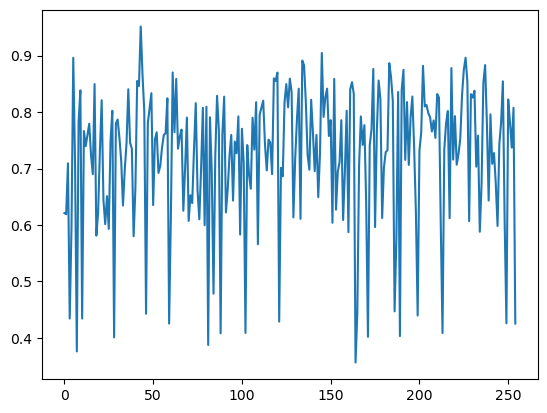

In [ ]:
plt.plot(means)
#plt.plot(obs_arr)

In [ ]:
[A,X1,W1] = montecarlo(X0,W0,100,4)

In [ ]:
X0 = [np.random.uniform(low = 0,high = 1) for i in range(0,10)]
W0 = [scipy.stats.poisson.pmf(k = 0.5, mu = particle) for particle in X0 ]

In [ ]:
montecarlo([np.random.uniforma])

In [ ]:
IDs

['Racism',
 'Sexual minorities',
 'Gender minorities',
 'Homosexuality',
 'Homophobia',
 'Misogyny',
 'Intersectionality',
 'Toxic',
 'Woke',
 'Cancel',
 'Gender roles',
 'Gender identity',
 'Feminism',
 'Masculinity',
 'Other gender',
 'Discrimination',
 'Equality',
 'Rainbow',
 'Prime Minister',
 'Government',
 'Parliament',
 'Agriculture',
 'Industry',
 'Climate',
 'NumOfArticles']

<Figure size 3200x6400 with 0 Axes>

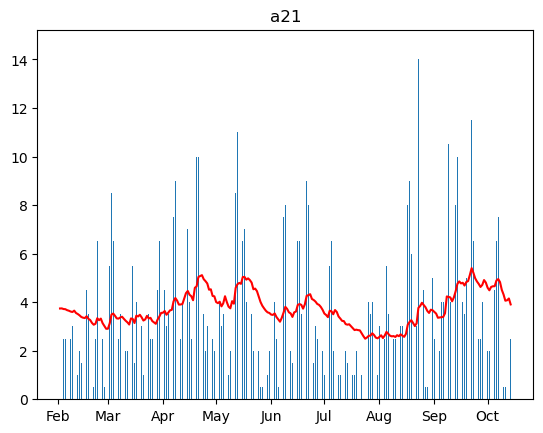

In [ ]:
Hello = MonteCarlo(analysis3)
Hello.movingaveragemontecarlo('a21',2,1000)
#[a,states] = Hello.general_filter(analysis3.df['a23'],110)



In [ ]:
4.00118936, 3.56475054, 4.02264832, 3.2153699 , 3.76145537,
       3.1426831 , 3.37277806, 3.50715877, 2.72544764, 2.55206073,
       3.38440022, 3.61817475, 3.24642849, 4.42006335, 4.30849244,
       4.40073753, 2.60147102, 3.56872025

In [ ]:
states

[array([4.00118936, 3.56475054, 4.02264832, 3.2153699 , 3.76145537,
        3.1426831 , 3.37277806, 3.50715877, 2.72544764, 2.55206073,
        3.38440022, 3.61817475, 3.24642849, 4.42006335, 4.30849244,
        4.40073753, 2.60147102, 3.56872025, 4.55758849, 3.48794395,
        4.40025943, 3.71939818, 4.42015418, 2.95081682, 3.62255573,
        3.12093599, 4.68540917, 4.01733507, 3.14803014, 4.18653506,
        2.7667024 , 3.74707887, 3.58549479, 3.93048722, 3.30707078,
        2.87816655, 3.50866002, 4.06779193, 3.76643871, 3.78400974,
        3.74948778, 2.64404331, 3.74133732, 3.9273064 , 4.58471703,
        3.52215121, 3.03730203, 3.37833741, 3.75606776, 4.05773145,
        3.37191797, 3.0262053 , 4.44208914, 3.34829452, 2.75455643,
        3.77227655, 3.70948893, 3.59299959, 3.49367109, 2.80740003,
        4.08862691, 3.29943642, 3.65007556, 3.80399568, 3.98769465,
        3.13725745, 3.64718797, 3.41222047, 3.13514024, 3.73420081,
        3.00771421, 3.66394458, 3.35648908, 3.54

Iteration:      1,   Func. Count:     33,   Neg. LLF: 711.4485454331788
Iteration:      2,   Func. Count:     66,   Neg. LLF: 711.1000471875153
Iteration:      3,   Func. Count:     99,   Neg. LLF: 758.599213017705
Iteration:      4,   Func. Count:    132,   Neg. LLF: 767.4689703796323
Iteration:      5,   Func. Count:    165,   Neg. LLF: 734.4564227131702
Iteration:      6,   Func. Count:    198,   Neg. LLF: 711.4556608964708
Iteration:      7,   Func. Count:    231,   Neg. LLF: 731.4439938247137
Iteration:      8,   Func. Count:    264,   Neg. LLF: 779.6703030496539
Iteration:      9,   Func. Count:    297,   Neg. LLF: 717.883636861805
Iteration:     10,   Func. Count:    330,   Neg. LLF: 697.9164103961878
Iteration:     11,   Func. Count:    363,   Neg. LLF: 694.8322214507596
Iteration:     12,   Func. Count:    395,   Neg. LLF: 695.2890490057468
Iteration:     13,   Func. Count:    428,   Neg. LLF: 695.3992073402679
Iteration:     14,   Func. Count:    461,   Neg. LLF: 693.50224522

C:\Users\kianv\AppData\Roaming\Python\Python39\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(


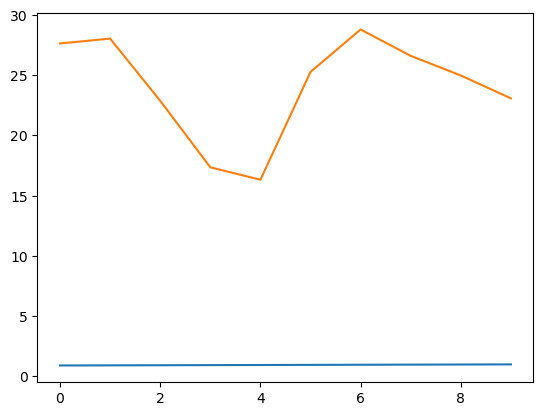

In [ ]:
# example of ARCH model
from random import gauss
from random import seed
from matplotlib import pyplot
from arch import arch_model

data = [float(x) for x in analysis3.df['a23'].values.tolist()]
# split into train/test
n_test = 10
train, test = data[:-n_test], data[-n_test:]
# define model
model = arch_model(train, mean='Zero', vol='GARCH', p=15, q=15)
# fit model
model_fit = model.fit()
# forecast the test set
yhat = model_fit.forecast(horizon=n_test)
# plot the actual variance
var = [i*0.01 for i in range(0,100)]
pyplot.plot(var[-n_test:])
# plot forecast variance
pyplot.plot(yhat.variance.values[-1, :])
pyplot.show()

In [ ]:
import pandas as pd
from arch import arch_model

# Load the data into a pandas dataframe
df = analysis3.df

# Define the GARCH model
garch_model = arch_model(df["a23"].values, mean="Zero", vol="GARCH", p=1, q=1)

# Fit the model to the data
garch_results = garch_model.fit()

# Print the summary of the fitted model
print(garch_results.summary())


ValueError: Buffer dtype mismatch, expected 'double' but got 'long long'

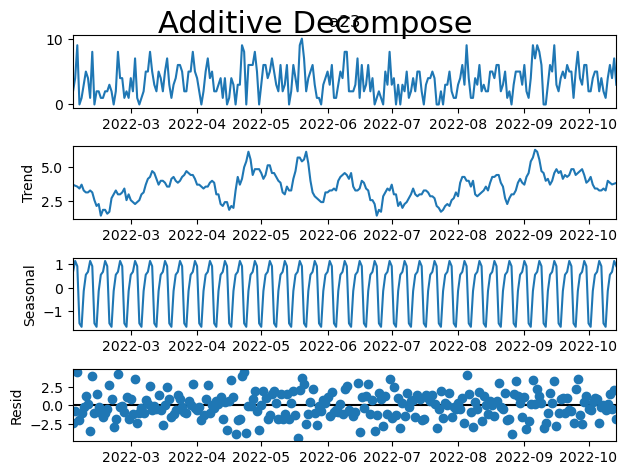

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
from dateutil.parser import parse

# Multiplicative Decomposition 
#result_mul = seasonal_decompose(tdata, model='multiplicative', extrapolate_trend='freq')

# Additive Decomposition
result_add = seasonal_decompose(analysis3.df['a23'], model='additive', extrapolate_trend='freq')

# Plot
#plt.rcParams.update({'figure.figsize': (10,10)})
#result_mul.plot().suptitle('Multiplicative Decompose', fontsize=22)
result_add.plot().suptitle('Additive Decompose', fontsize=22)
plt.show()


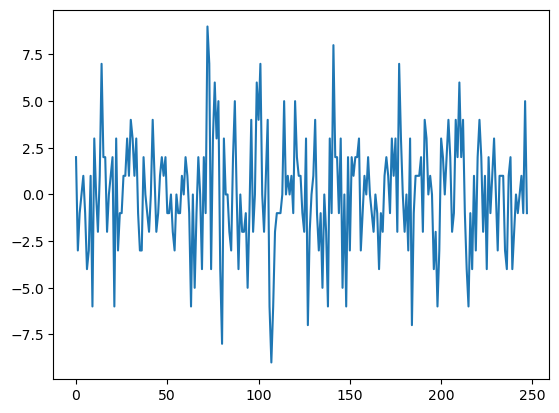

In [ ]:
diff = list()
tdf = analysis3.df['a23'].values
days_in_year = 7
for i in range(days_in_year, len(tdf)):
 value = tdf[i] - tdf[i - days_in_year]
 diff.append(value)
pyplot.plot(diff)
pyplot.show()

In [ ]:
from pandas import datetime
from pandas import read_csv
from pandas import DataFrame
from statsmodels.tsa.arima.model import ARIMA
from matplotlib import pyplot

import pmdarima as pm

C:\Users\kianv\AppData\Local\Temp\ipykernel_3696\3846794530.py:1: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  from pandas import datetime


In [ ]:
data = diff
model = pm.auto_arima(data, start_p=1, start_q=1,
                      test='adf',       # use adftest to find optimal 'd'
                      max_p=3, max_q=3, # maximum p and q
                      m=1,              # frequency of series
                      d=None,           # let model determine 'd'
                      seasonal=False,   # No Seasonality
                      start_P=0, 
                      D=0, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                      stepwise=True)
model.summary()

n_periods = 24
fitted, confint = model.predict(n_periods=n_periods, return_conf_int=True)
index_of_fc = pd.date_range(data.index[-1], periods = n_periods, freq='MS')

# make series for plotting purpose
fitted_series = pd.Series(fitted, index=index_of_fc)
lower_series = pd.Series(confint[:, 0], index=index_of_fc)
upper_series = pd.Series(confint[:, 1], index=index_of_fc)

# Plot
plt.plot(data)
plt.plot(fitted_series, color='darkgreen')
plt.fill_between(lower_series.index, 
                 lower_series, 
                 upper_series, 
                 color='k', alpha=.15)

plt.title("SARIMA - Final Forecast of a10 - Drug Sales")
plt.show()

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=1245.826, Time=0.04 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=1247.237, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=1244.373, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=1244.999, Time=0.02 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=1245.439, Time=0.02 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=1240.274, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=1241.877, Time=0.13 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=inf, Time=0.27 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=1247.111, Time=0.05 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=1247.028, Time=0.03 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.27 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=1242.271, Time=0.07 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 0.971 seconds


TypeError: 'builtin_function_or_method' object is not subscriptable

In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss
result = kpss(analysis3.df['a23'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# Time Series Decomposition
df = np.log(analysis3.df['a23'].values)
result_mul = seasonal_decompose(df, model='additive', period = 7 )

# Deseasonalize
deseasonalized = df / result_mul.seasonal

# Plot
plt.plot(deseasonalized)



KPSS Statistic: 0.212935
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(
C:\Users\kianv\AppData\Local\Temp\ipykernel_24248\2797631332.py:10: RuntimeWarning: divide by zero encountered in log
  df = np.log(analysis3.df['a23'].values)


ValueError: This function does not handle missing values

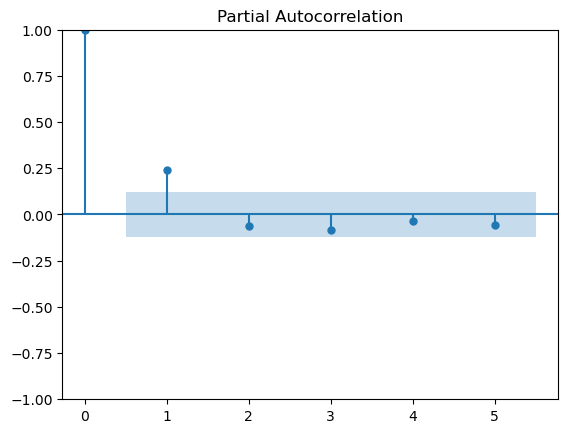

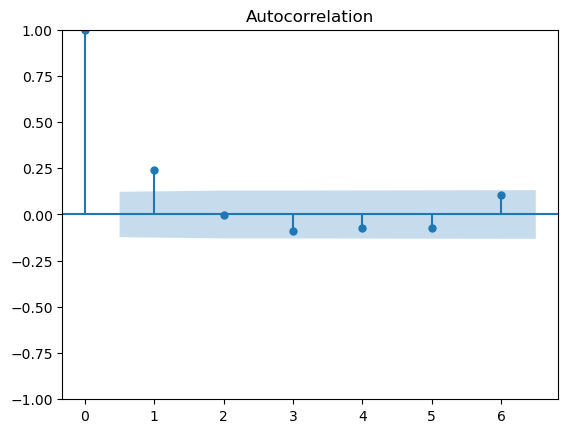

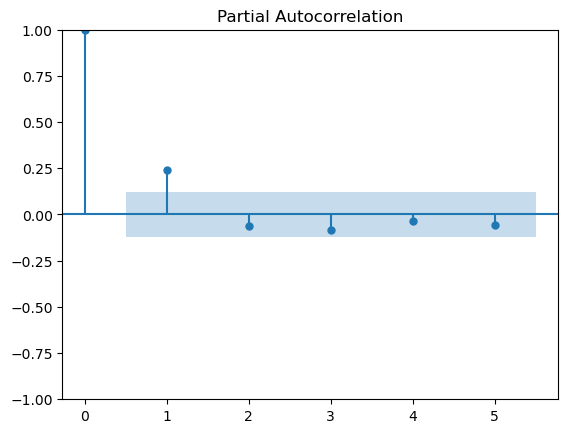

In [ ]:
tdata = analysis3.df['a23'].values.tolist()
plot_acf(tdata,lags=6)
plot_pacf(tdata,lags = 5)

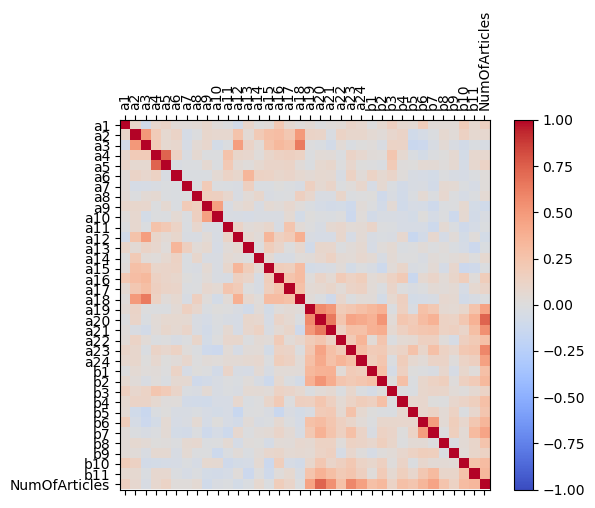

In [ ]:
data = analysis3.df
corr = analysis3.df.corr()
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(corr,cmap='coolwarm', vmin=-1, vmax=1)
fig.colorbar(cax)
ticks = np.arange(0,len(data.columns),1)
ax.set_xticks(ticks)
plt.xticks(rotation=90)
ax.set_yticks(ticks)
ax.set_xticklabels(data.columns)
ax.set_yticklabels(data.columns)
plt.show()

[1.00e-04 1.00e-04 0.00e+00 0.00e+00 1.00e-04 3.00e-04 1.00e-04 3.00e-04
 6.00e-04 3.00e-04 3.00e-04 8.00e-04 1.10e-03 9.00e-04 1.20e-03 1.30e-03
 2.10e-03 2.00e-03 2.80e-03 2.50e-03 3.80e-03 5.10e-03 4.10e-03 4.90e-03
 5.00e-03 6.70e-03 8.40e-03 8.30e-03 8.90e-03 1.10e-02 1.43e-02 1.39e-02
 1.44e-02 1.64e-02 1.69e-02 2.22e-02 2.11e-02 2.24e-02 2.45e-02 2.29e-02
 2.45e-02 2.77e-02 2.94e-02 2.75e-02 2.69e-02 2.75e-02 2.87e-02 3.28e-02
 3.02e-02 2.83e-02 3.13e-02 2.86e-02 3.01e-02 2.97e-02 2.66e-02 2.61e-02
 2.48e-02 2.17e-02 2.26e-02 2.03e-02 1.78e-02 1.86e-02 1.67e-02 1.76e-02
 1.31e-02 1.14e-02 1.20e-02 9.60e-03 8.60e-03 7.30e-03 8.60e-03 6.40e-03
 5.60e-03 5.20e-03 3.90e-03 3.80e-03 2.00e-03 2.50e-03 2.50e-03 2.10e-03
 1.20e-03 6.00e-04 8.00e-04 4.00e-04 1.00e-03 1.10e-03 5.00e-04 3.00e-04
 2.00e-04 2.00e-04 3.00e-04 2.00e-04 3.00e-04 0.00e+00 0.00e+00 1.00e-04
 0.00e+00 0.00e+00 1.00e-04]


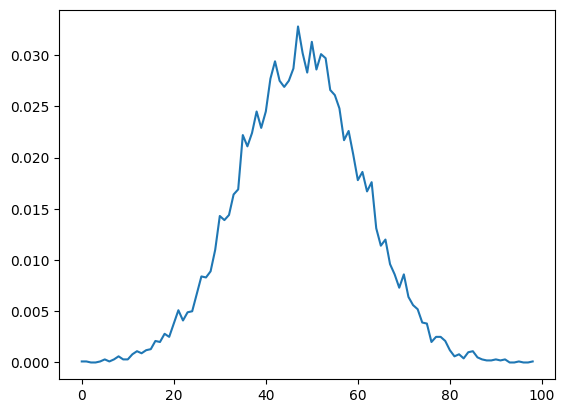

In [ ]:
def monte_carlo_pdf_estimator(num_samples, sample_function,value):
    # Generate samples from the sample function
    samples = np.zeros(num_samples)
    for i in range(num_samples):
        samples[i] = sample_function()

    # Estimate the pdf by counting the occurrences of each value and normalizing
    bin_edges = np.linspace(np.min(samples), np.max(samples), num=100)
    hist, _ = np.histogram(samples, bins=bin_edges, density=True)
    pdf = hist / np.sum(hist)
    return(pdf)
def unif():
    return(np.random.normal())
dist = monte_carlo_pdf_estimator(10000,unif,-2)
print(dist)
plt.plot(dist)
#np.interp(0.75, x,y)

[-0.00013554 -0.00019916 -0.00042466 ... -0.0006911   0.0001452
  0.00014722]


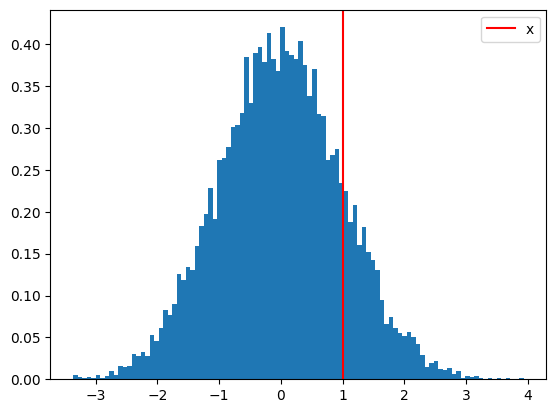

In [ ]:
import numpy as np
import random
import matplotlib.pyplot as plt
def monte_carlo_probability_estimator(num_samples, sample_function, x):
    # Generate samples from the sample function
    global samples
    samples=  np.zeros(num_samples)
    for i in range(num_samples):
        samples[i] = sample_function()

    # Estimate the probability by counting the occurrences of x
    cdf = np.linspace(0, 1, len(samples))
    probability = np.mean(samples < x)
    pdf = np.gradient(cdf, samples)
    return pdf

# Define the sample function
def sample_function():
    return np.random.normal(0, 1)

# Define the value x
x = 1

# Run the Monte Carlo simulation
probability = monte_carlo_probability_estimator(10000, sample_function, x)
print(probability)
# Plot the results
plt.hist(samples, bins=100, density=True)
plt.axvline(x, color='red', label='x')
plt.legend()
plt.show()


In [ ]:
import numpy as np

# Define the set of samples
samples = np.random.normal(0, 1, 10000)

# Define the specific sample
sample = 0

# Calculate the relative frequency of the specific sample
probability = np.sum(samples == sample) / len(samples)

print("The probability of the specific sample is:", probability)


The probability of the specific sample is: 0.0


In [ ]:
import numpy as np

# Define the set of samples
samples = np.random.normal(0, 1, 10000)

# Define the specific sample
sample = 0

# Calculate the relative frequency of the specific sample
probability = np.sum(samples == sample) / len(samples)

print("The probability of the specific sample is:", probability)


The probability of the specific sample is: 0.0


In [ ]:
list(range(9,-1,-1))

[9, 8, 7, 6, 5, 4, 3, 2, 1, 0]

```analysis = Model()
filter = MonteCarlo(analysis)
for ID in list(analysis.df):
    filter.movingaveragemontecarlo(ID,2,2500)
    

In [ ]:
analysis2 = Model()
filter2 = MonteCarlo(Model())
filter2.smc_smoother(observations= analysis2.df['a20'],transition_kernel= filter2.StateSpace_iplus1,observation_kernel= filter2.hiddenmodel_iplus1,num_steps=100,num_particles= 30)

Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities
Process our DataFrame:                   Successfully parsed and formatted our data
Process our Cumulative Probabilities DataFrame:     TEST-
                    Binomial Probabilities is the same as last row of cumulative probabilities


C:\Users\kianv\AppData\Local\Temp\ipykernel_2760\3567369889.py:190: RuntimeWarning: invalid value encountered in scalar divide
  smoothed_weights[i, j] = weights[step, i] * backward_kernel[i, j] / np.dot(backward_kernel[:, j], weights[step, :])


array([[        nan,         nan,         nan, ...,         nan,
                nan,         nan],
       [        nan,         nan,         nan, ...,         nan,
                nan,         nan],
       [        nan,         nan,         nan, ...,         nan,
                nan,         nan],
       ...,
       [        nan,         nan,         nan, ...,         nan,
                nan,         nan],
       [        nan,         nan,         nan, ...,         nan,
                nan,         nan],
       [12.288036  , 10.06780218, 13.24859548, ..., 10.33969605,
        10.54145199, 10.33969605]])

In [ ]:
analysis = Model()
df = analysis.df
#analysis.MA_binomest_CI_plot('a5')
#analysis.CI_of_estimates_plot()
#analysis.binplot2()

In [ ]:
def clopper_pearson(x, n, alpha=0.05):
    """Estimate the confidence interval for a sampled Bernoulli random
    variable.
    `x` is the number of successes and `n` is the number trials (x <=
    n). `alpha` is the confidence level (i.e., the true probability is
    inside the confidence interval with probability 1-alpha). The
    function returns a `(low, high)` pair of numbers indicating the
    interval on the probability.
    """
    
    b = scipy.stats.beta.ppf
    lo = b(alpha / 2, x, n - x + 1)
    hi = b(1 - alpha / 2, x + 1, n - x)
    return 0.0 if math.isnan(lo) else lo, 1.0 if math.isnan(hi) else hi

from FunctionFile import * 

In [ ]:
#Create a dataframe that computes the cumulative probability up until that date of a keyword occuring
cumprob = df.copy()

for column in list(cumprob)[:-1]:
    cumprob[column] = [sum(cumprob[column][:i+1])/sum(cumprob['NumOfArticles'][:i+1]) for i in range(0,len(cumprob[column]))]
cumprob['NumOfArticles'] =np.cumsum(cumprob['NumOfArticles'])

#Compute Binomial Estimates
binomestimates = [sum(df[column])/sum(df['NumOfArticles']) for column in list(df)[:-1]]

#Check that estimates line up with cumulative probaiblities at the end of the dataframe
for i in range(0,len(cumprob.iloc[-1][:-1])):
    if (cumprob.iloc[-1][:-1][i] != binomestimates[i]):
        print(False)
        break
    if i == len(cumprob.iloc[-1][:-1])-1:
        print("Binomial Probabilities is the same as last row of cumulative probabilities")
    

#TEST is valid.


Binomial Probabilities is the same as last row of cumulative probabilities


<Figure size 1600x1600 with 0 Axes>

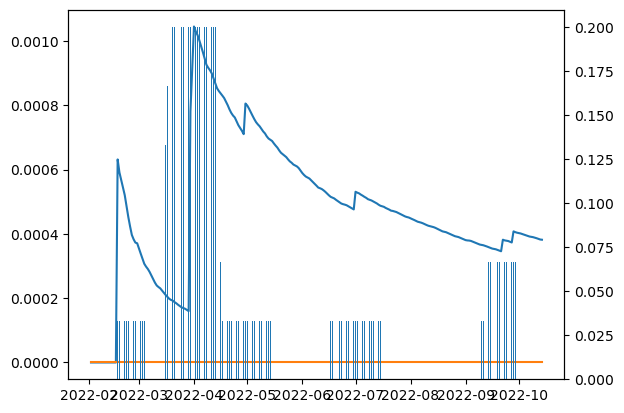

In [ ]:
movingaverage(data, 'd5', 30, 0.05)

In [ ]:
cols = list(cumprobdata)
cols = cols[1:-1]
cols
p = []
for ID in cols:
    p.append(cumprobdata.tail(1)[ID])

In [ ]:
lot = []
hit = []
for i in p:
    successes = i*len(cumprobdata)
    total = len(cumprobdata)
    lo, hi = clopper_pearson(successes, total)
    lot.append(lo[0])
    hit.append(hi[0])
y=[]
for i in range(len(p)):
    y.append((lot[i],hit[i]))
x = [i for i in range(len(cols))]
plt.scatter(x,p, s = 10)
plt.plot((x,x),([i for (i,j) in y], [j for (i,j) in y]),c='black')
plt.show()
#remember to define p first!

def binplot(df):
    cols = list(df)[0:-1]
    hi = []
    k = 0 
    for ID in cols: 
        hi.append(kstest(df[ID], 'norm'))
        myarray = df[ID]
        weights = np.ones_like(myarray) / len(myarray)
        plt.hist(myarray, weights=weights)

        n = len(data)
        # defining list of r values
        r_values = list(range(0,30))
        # list of pmf values
        dist = [binom.pmf(r, n, p[k]) for r in r_values ]
        # plotting the graphs
        fg = Figure()
        ax = fg.gca()
        plt.plot(r_values, dist)
        plt.ylabel(ID)
        plt.xlabel(str(p[k]*len(data)))
        print(p[k])
        plt.show()
        k+=1
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    return(hi)

In [ ]:
#remember to define p first!

def binplot2(df):
    cols = list(df)[0:-1]
    hi = []
    k = 0 
    for ID in cols: 
        hi.append(kstest(df[ID], 'norm'))
        myarray = df[ID]
        weights = np.ones_like(myarray) / len(myarray)
        plt.hist(myarray, weights=weights)
        p_hat = np.mean(myarray)/len(myarray)
        n = len(data)
        # defining list of r values
        r_values = list(range(0,30))
        # list of pmf values
        dist = [binom.pmf(r, n, p_hat) for r in r_values ]
        # plotting the graphs
        fig, ax = plt.subplots()
        plt.plot(r_values, dist)
        plt.ylabel(ID)
       # plt.xlabel(str(p[k]*len(data)))#list index out of range!!!
        #print(p[k])
        k+=1
        plt.savefig("hist" + ID+'.png')
    return(hi)

C:\Users\kianv\AppData\Local\Temp\ipykernel_18556\2860582045.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


[KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=0.5, pvalue=1.7858898822804354e-59),
 KstestResult(statistic=

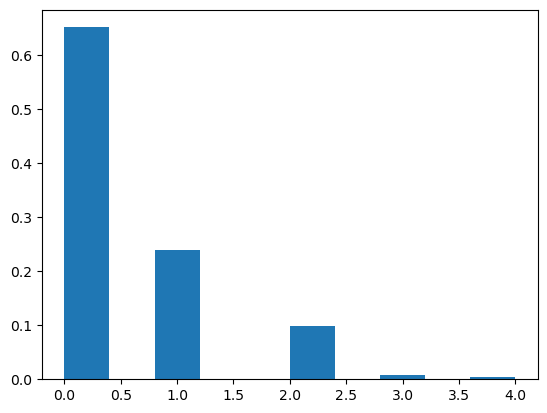

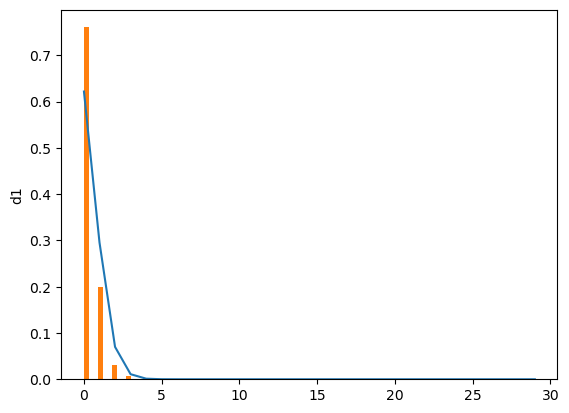

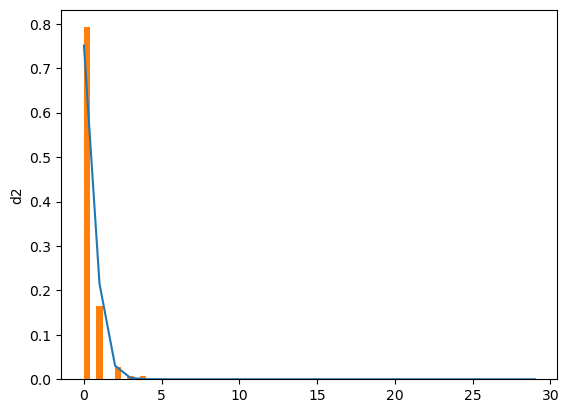

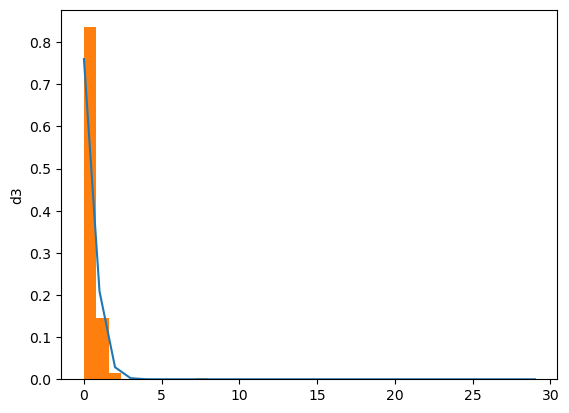

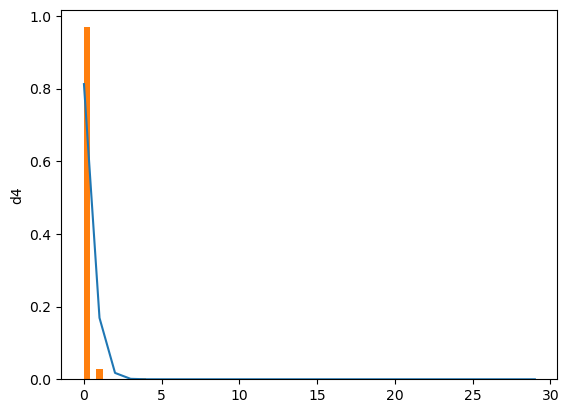

...

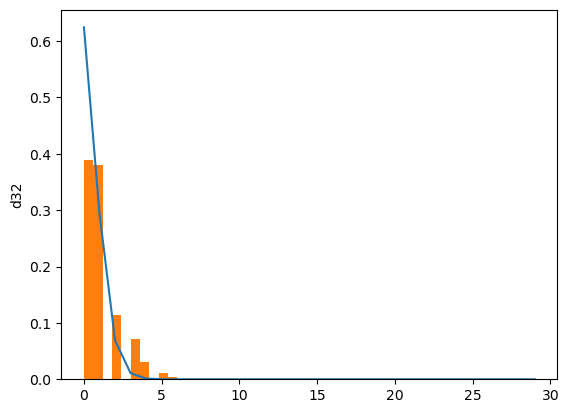

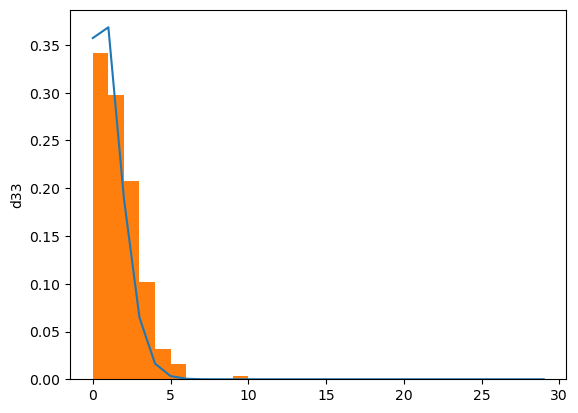

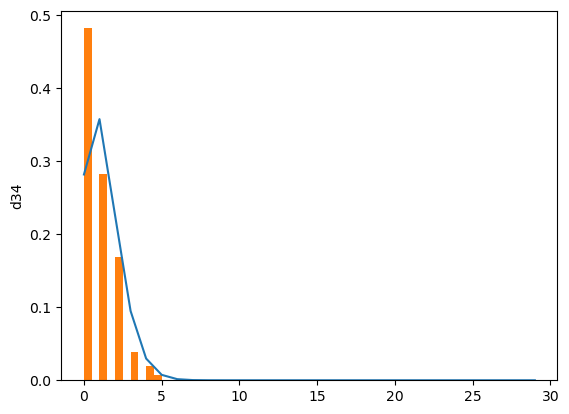

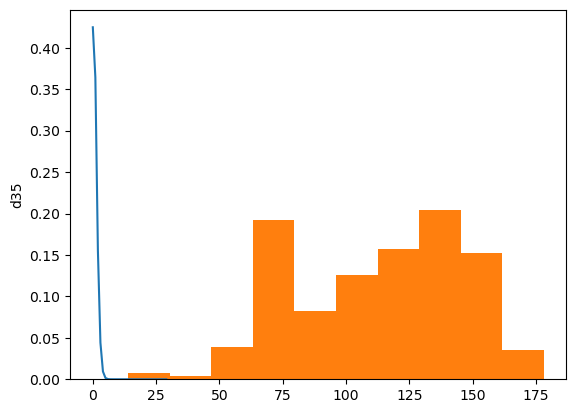

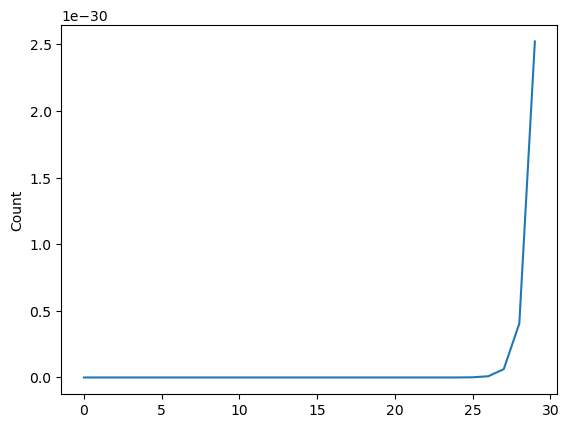

In [ ]:
binplot2(data)

In [ ]:
from scipy.stats import poisson

In [ ]:
x0 = np.random.uniform()

In [ ]:
def Xtplus1(Xt_1):
    return(Xt_1*np.random.uniform(low = 0.8, high = 1.2))

def Wt(Yt,Xt):
    return(poisson.pmf(Yt, mu=Xt))

Need to find dataframe that stipulates the probabilities!

In [ ]:
probdata = pd.DataFrame()
cols = list(data)
cols = cols[:-2]
for ID in cols:
    probdata[ID] = data[ID]/data['Count']

We can now specify the pmf. i.e. Y - probdata[ID}.values

In [ ]:
def multinomial_resample(weights):
    """ This is the naive form of roulette sampling where we compute the
    cumulative sum of the weights and then use binary search to select the
    resampled point based on a uniformly distributed random number. Run time
    is O(n log n). You do not want to use this algorithm in practice; for some
    reason it is popular in blogs and online courses so I included it for
    reference.
   Parameters
   ----------
    weights : list-like of float
        list of weights as floats
    Returns
    -------
    indexes : ndarray of ints
        array of indexes into the weights defining the resample. i.e. the
        index of the zeroth resample is indexes[0], etc.
    """
    cumulative_sum = np.cumsum(weights)
    #cumulative_sum[-1] = 1.  # avoid round-off errors: ensures sum is exactly one
    return np.searchsorted(cumulative_sum, random(len(weights)))

In [ ]:
import numpy as np
from numpy.random import random

def resample(weights):
    cumulative_sum = np.cumsum(weights)
    cumulative_sum[-1] = 1  # avoid round-off errors: ensures sum is exactly one
    return np.searchsorted(cumulative_sum, np.random(len(weights)))

def Filter(X,Yobs,N):
    W = [0 for i in range(N)]
    #Draw
    for i in range(N):
        #Draw/Mutation
        X[i] = Xtplus1(X[i]) #unif
        #Compute weights
        W[i] = Wt(Yobs,X[i])

    #Normalise weights
    sumW = sum(W)
    for i in range(N):
        W[i] = W[i]/sumW
        
    #Resample from these weights    

    I = multinomial_resample(W)
    
    #Convert to state space vectors
    I = np.array(I)
    X = np.array(X)
    X = X[I]
    
    X_est = sum(X)/N
        
    return(X,X_est)    

In [ ]:
np.random.choice([1,2,3,4], size=4, replace=True, p=W)

ValueError: 'a' and 'p' must have same size

X0 = [np.random.uniform() for i in range(0,100)]
W = [0 for i in range(len(X0))]
Y = data['d2'].values

In [ ]:
N = 100
X0 = [np.random.uniform() for i in range(0,100)]
xstart = X0
rate =np.zeros(len(Y))
X=X0
for i in range(0,len(Y)):
    [X,X_est] = Filter(X,Y[i],N)
    rate[i] = X_est

In [ ]:
def general_filter(Y,N,df,ID):
    d = np.array(df[ID])
    X0 = [np.mean(d) for i in range(0,N)]
    X = X0
    rate =np.zeros(len(Y))
    for i in range(0,len(Y)):
        [X,X_est] = Filter(X,Y[i],N)
        rate[i] = X_est
    return(rate)

In [ ]:
df = analysis.df

In [ ]:
#Draw values from initial distribution.
X0 = [np.random.uniform() for i in range(0,100)]
W = [0 for i in range(len(X0))]
Y = df['a2'].values
#Compute first weights
for i in range(0,len(X0)):
    W[i] = Wt(Y[0],X0[i])
for j in range(len(X0)):
    W[i] = W[i]/sum(W)


#for i in range(0,30):
#    X0,W = Filter(X0,W,Y)

NameError: name 'Wt' is not defined

In [ ]:
general_filter()

TypeError: general_filter() missing 2 required positional arguments: 'df' and 'ID'

In [ ]:
def Xtplus1(Xt_1):
    return(Xt_1*np.random.uniform(low = 0.8, high = 1.2))
    #return(Xt_1 *dnp.random.lognormal(mean=0.0, sigma=1.0)
    #return(Xt_1*np.random.exponential(scale = 1))
def Wt(Yt,Xt):
    return(poisson.pmf(Yt, mu=Xt))

In [ ]:
def movingaveragemontecarlo(data,ID,K,N):
    p_est_dict = {}
    #changed plot to normal data
    vals = data[ID]
    df_dummy = df.copy()
    # p_est_array = np.array(Ksum(vals,K))/K
    rate = general_filter(df[ID],N,df,ID)
    
    #dfp.rolling(7, center=True).mean()
    hi = pd.DataFrame(vals)
    dude = pd.DataFrame(hi).rolling(K, center=True).mean()
    p_est_dict[ID] = dude[ID]
    p_est_array = dude[ID]
    
    hi = pd.DataFrame(df[ID])
    dude = pd.DataFrame(hi).rolling(K, center=True).mean()
    #return(d
    
    
    df_dummy['Plottingrate'] = rate
    
    figure(figsize=(10, 20), dpi=320)
    fig, ax = plt.subplots()
    #ax1.plot(df.index.values,df_dummy['Plottingrate'], color = 'red')
    #ax1.set_ylabel('SMC')
    
    #ax2 = ax1.twinx()
    #ax2.bar(df.index.values, dude[ID] ,width = 0.3)
    #ax2.set_ylabel('Moving Average')
    
    plt.plot(df.index.values,df_dummy['Plottingrate'], color = 'red')
    ax.bar(df.index.values, dude[ID] ,width = 0.3)
    
    #Ksum(df[ID].values,30)
    #
    #plt.plot(d0f.index.values, cumdata[ID])
    # ax1.plot(df.index.values,df_dummy['Plottingrate'], "r-")
    # ax1.ylabel('SMC')
    plt.title(ID)
    plt.savefig('new ' +ID+'.png')

Go through the documentaiton for this:
https://matplotlib.org/stable/gallery/subplots_axes_and_figures/subplots_demo.html 
Make sure that you are using the correct 

C:\Users\kianv\AppData\Local\Temp\ipykernel_18556\3830125349.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure(figsize=(10, 20), dpi=320)


<Figure size 3200x6400 with 0 Axes>

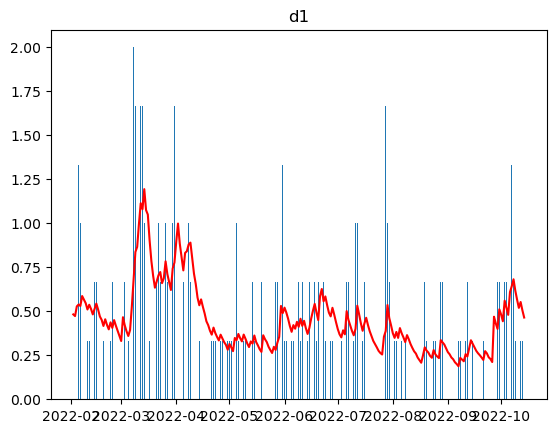

<Figure size 3200x6400 with 0 Axes>

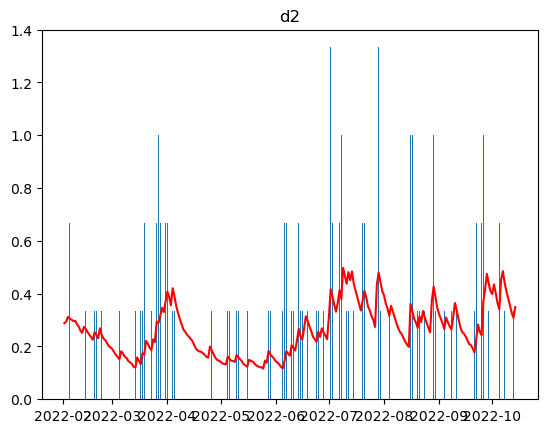

<Figure size 3200x6400 with 0 Axes>

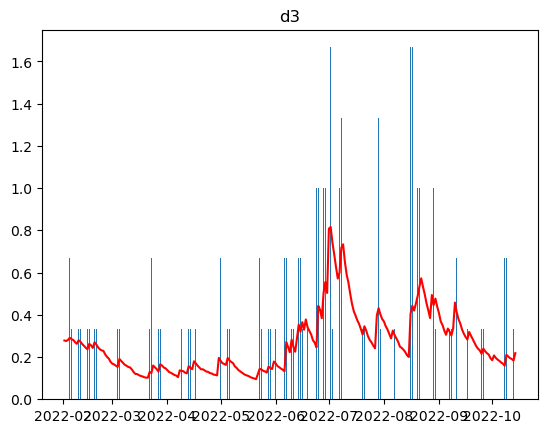

<Figure size 3200x6400 with 0 Axes>

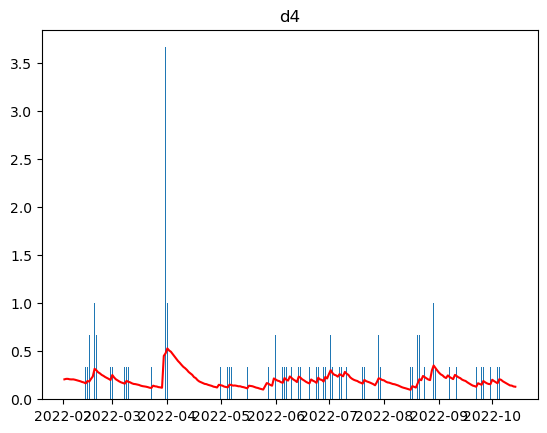

<Figure size 3200x6400 with 0 Axes>

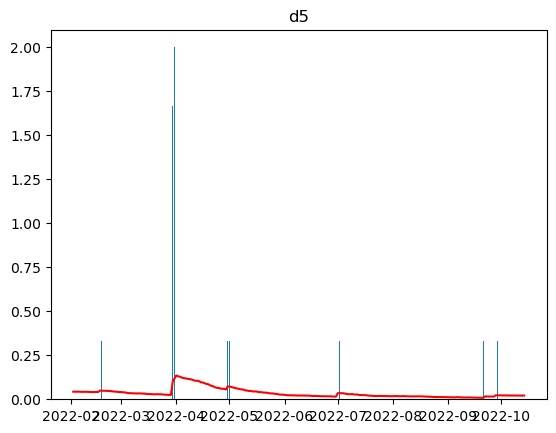

<Figure size 3200x6400 with 0 Axes>

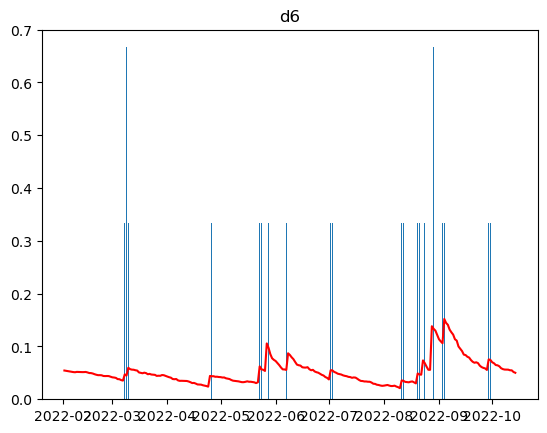

<Figure size 3200x6400 with 0 Axes>

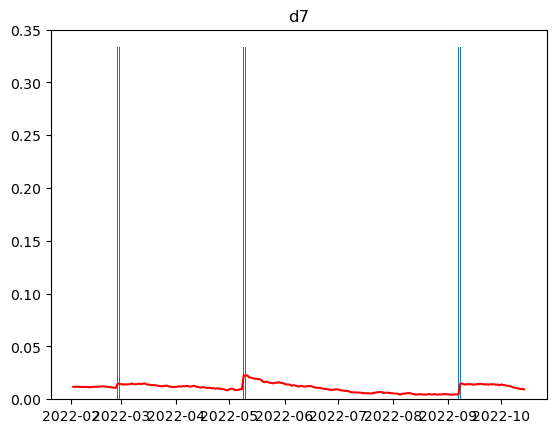

<Figure size 3200x6400 with 0 Axes>

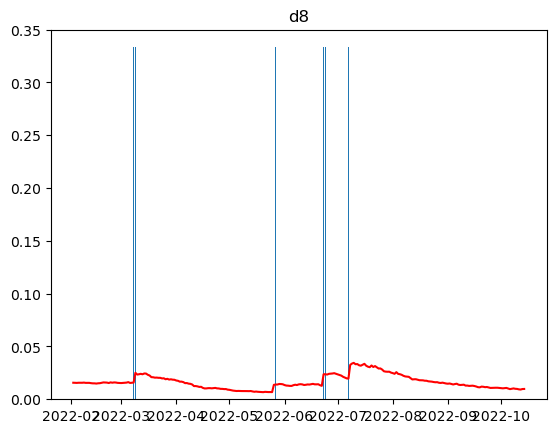

<Figure size 3200x6400 with 0 Axes>

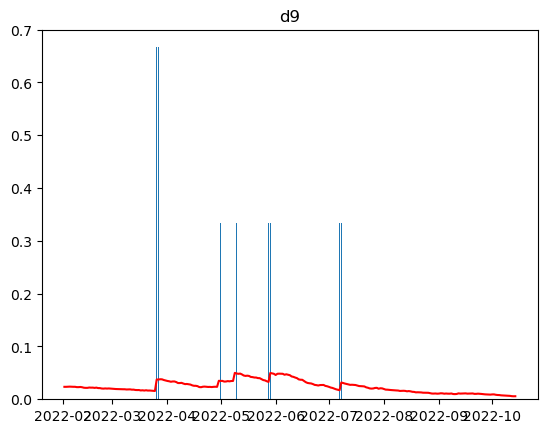

<Figure size 3200x6400 with 0 Axes>

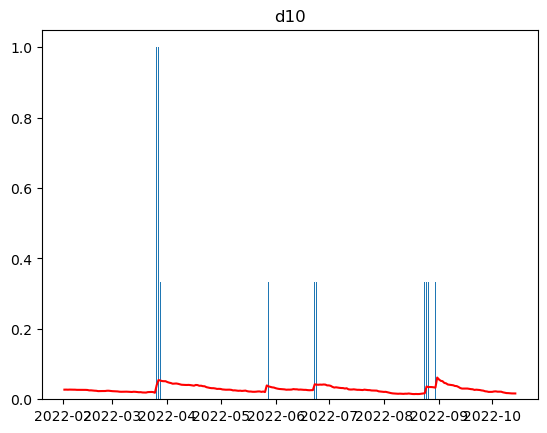

<Figure size 3200x6400 with 0 Axes>

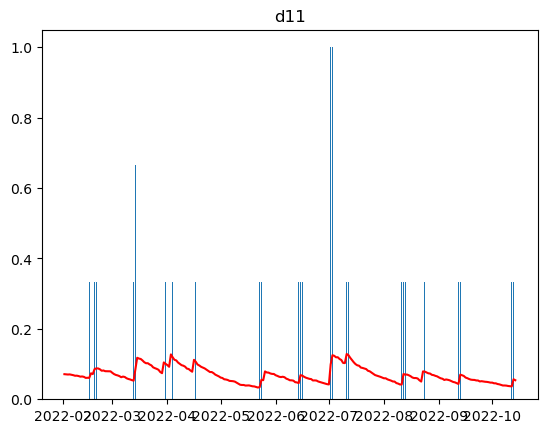

<Figure size 3200x6400 with 0 Axes>

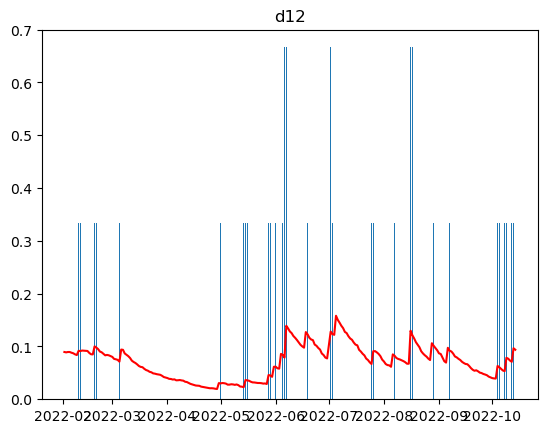

<Figure size 3200x6400 with 0 Axes>

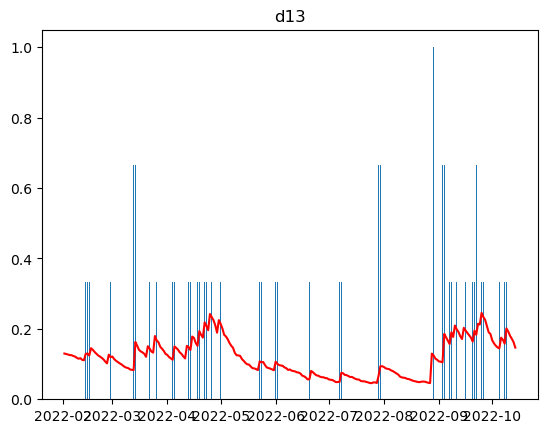

<Figure size 3200x6400 with 0 Axes>

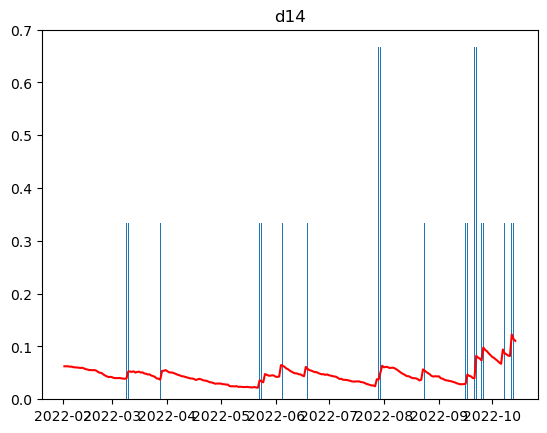

<Figure size 3200x6400 with 0 Axes>

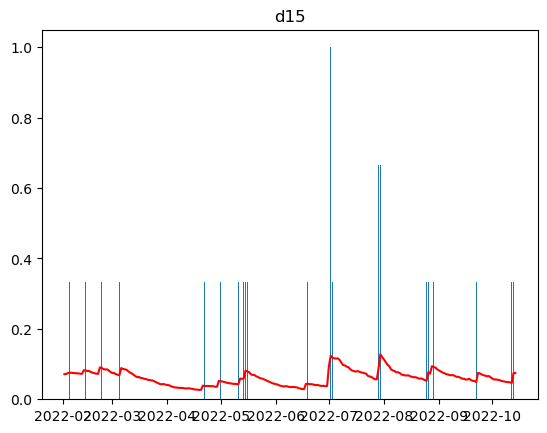

<Figure size 3200x6400 with 0 Axes>

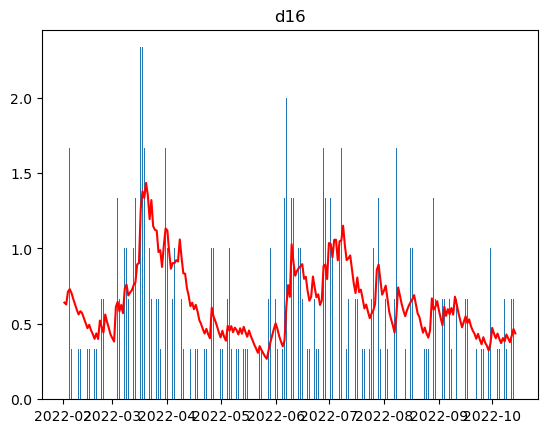

<Figure size 3200x6400 with 0 Axes>

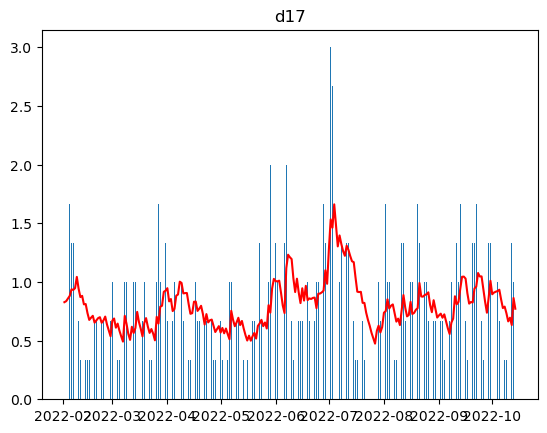

<Figure size 3200x6400 with 0 Axes>

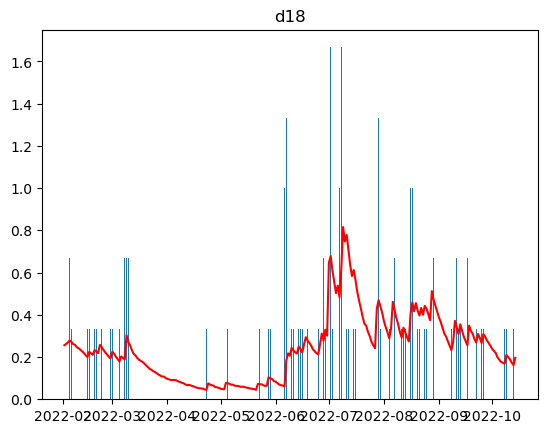

<Figure size 3200x6400 with 0 Axes>

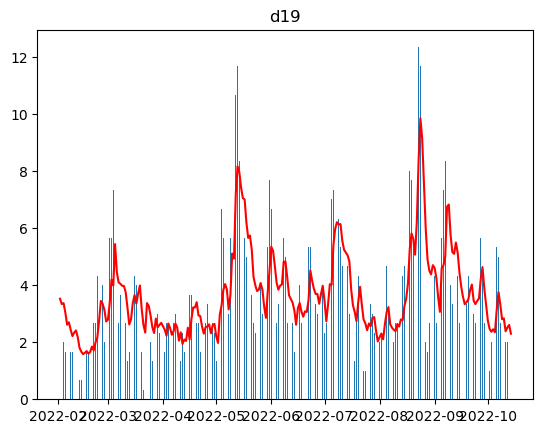

<Figure size 3200x6400 with 0 Axes>

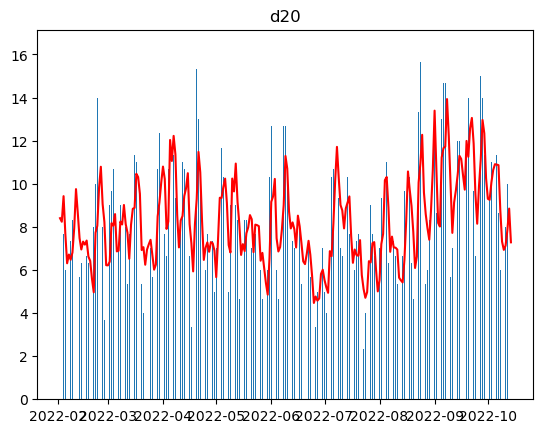

<Figure size 3200x6400 with 0 Axes>

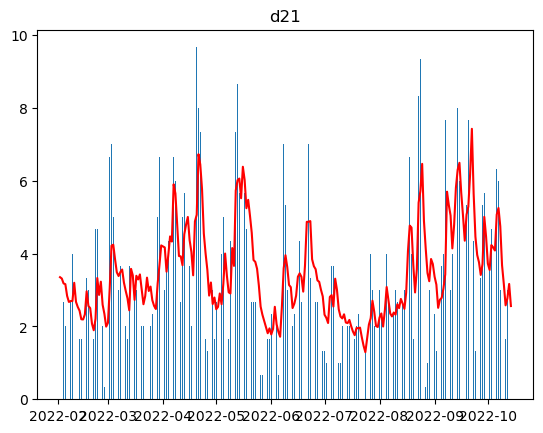

<Figure size 3200x6400 with 0 Axes>

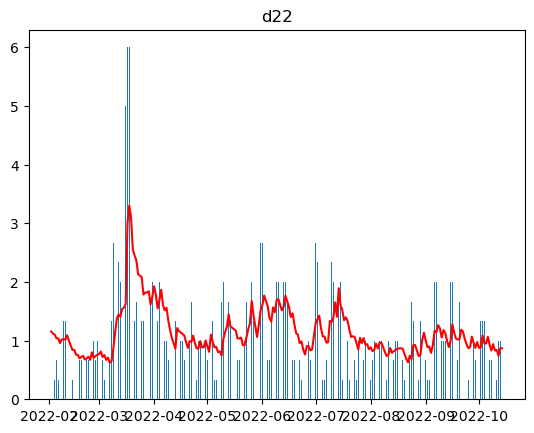

<Figure size 3200x6400 with 0 Axes>

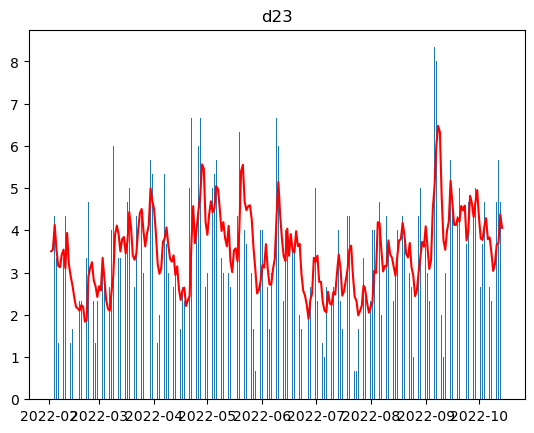

<Figure size 3200x6400 with 0 Axes>

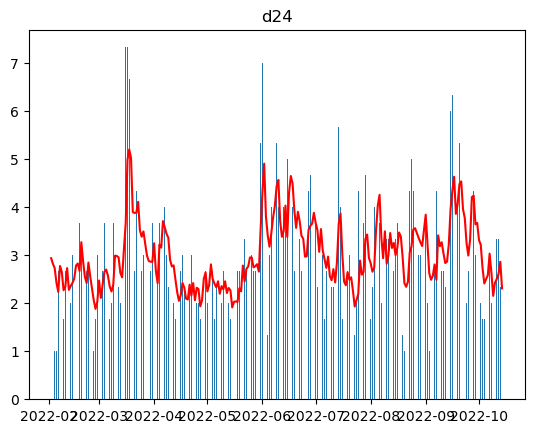

In [ ]:
cols = list(data)
cols = cols[0:-2]
for ID in cols:
    movingaveragemontecarlo(data,ID,3,1000)